In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import matplotlib.colors
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy.stats import chi2
from numba import njit,prange
import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.05  # previous pdf hatch linewidth
from matplotlib.dates import DateFormatter

from scipy.stats import linregress
from scipy import interpolate

from kneed import KneeLocator
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

In [2]:
normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}

imin = 32 ; imax = -30
jmin = 20 ; jmax = -15
ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-ERA-20C/MARgrid_EUf.nc')
lon = ds.LON[jmin:jmax,imin:imax]
lat = ds.LAT[jmin:jmax,imin:imax]
H = np.array(ds.SH[jmin:jmax,imin:imax])

In [3]:
def detect_alps(H):
    nlat,nlon = np.shape(H)
    mask = np.bool_(np.zeros((nlat,nlon)))
    r = 4
    for j in range(r,nlat-r):
        for i in range(r,nlon-r):
            mask[j,i] = np.logical_and(H[j,i]>360 ,np.any(H[j-r:j+r,i-r:i+r]>1300))
            # mask[j,i] = np.std(H[j-r:j+r,i-r:i+r])>200
    return mask
alps = detect_alps(H)
alps[lon<4.8] = False
alps[np.logical_and(lon>10,lat<45.2)] = False

north_alps = np.copy(alps)
north_alps[lon>8.6] = False
north_alps[lat<45] = False
#north_alps[lat>46.5] = False

south_alps = np.copy(alps)
south_alps[lat>45] = False

east_alps = np.copy(alps)
east_alps[lon<8.6] = False

### Max warming

In [4]:
wp_meanseason_meanT = np.load('/bettik/castelli/data/saved_data_MAR_ECEarth3/wp_meanseason_meanT.npy')[:,:,jmin:jmax,imin:imax]

wp_meanseason_meanT_hist = wp_meanseason_meanT[:54,:,:,:]
wp_meanseason_meanT_fut = wp_meanseason_meanT[55:,:,:,:]

origin_T_hist=np.full(wp_meanseason_meanT_hist.shape[1:4],np.nan)
slope_T_hist=np.full(wp_meanseason_meanT_hist.shape[1:4],np.nan)
pvalue_T_hist=np.full(wp_meanseason_meanT_hist.shape[1:4],np.nan)

origin_T_fut=np.full(wp_meanseason_meanT_fut.shape[1:4],np.nan)
slope_T_fut=np.full(wp_meanseason_meanT_fut.shape[1:4],np.nan)
pvalue_T_fut=np.full(wp_meanseason_meanT_fut.shape[1:4],np.nan)

for i in range(wp_meanseason_meanT.shape[3]):
    # print(str(lon)+'/'+str(les_season_maxT.shape[3]),end=' ')
    for j in range(wp_meanseason_meanT.shape[2]):
        for season in range(4):
            linregress_T_hist = linregress(np.arange(wp_meanseason_meanT_hist.shape[0]), wp_meanseason_meanT_hist[:,season,j,i])
            origin_T_hist[season][j][i] = linregress_T_hist.intercept
            slope_T_hist[season][j][i] = linregress_T_hist.slope
            pvalue_T_hist[season][j][i] = linregress_T_hist.pvalue
            
            linregress_T_fut = linregress(np.arange(wp_meanseason_meanT_fut.shape[0]), wp_meanseason_meanT_fut[:,season,j,i])
            origin_T_fut[season][j][i] = linregress_T_fut.intercept
            slope_T_fut[season][j][i] = linregress_T_fut.slope
            pvalue_T_fut[season][j][i] = linregress_T_fut.pvalue

In [5]:
slope_T_hist.shape

(4, 91, 139)

### JJAS, DJFM and AMON regions

In [12]:
region_masks = [alps,alps_JJAS,alps_DJFM,alps_AMON]
names_regions = ['Alps','Alps JJAS','ALPS DJFM','Alps AMON']

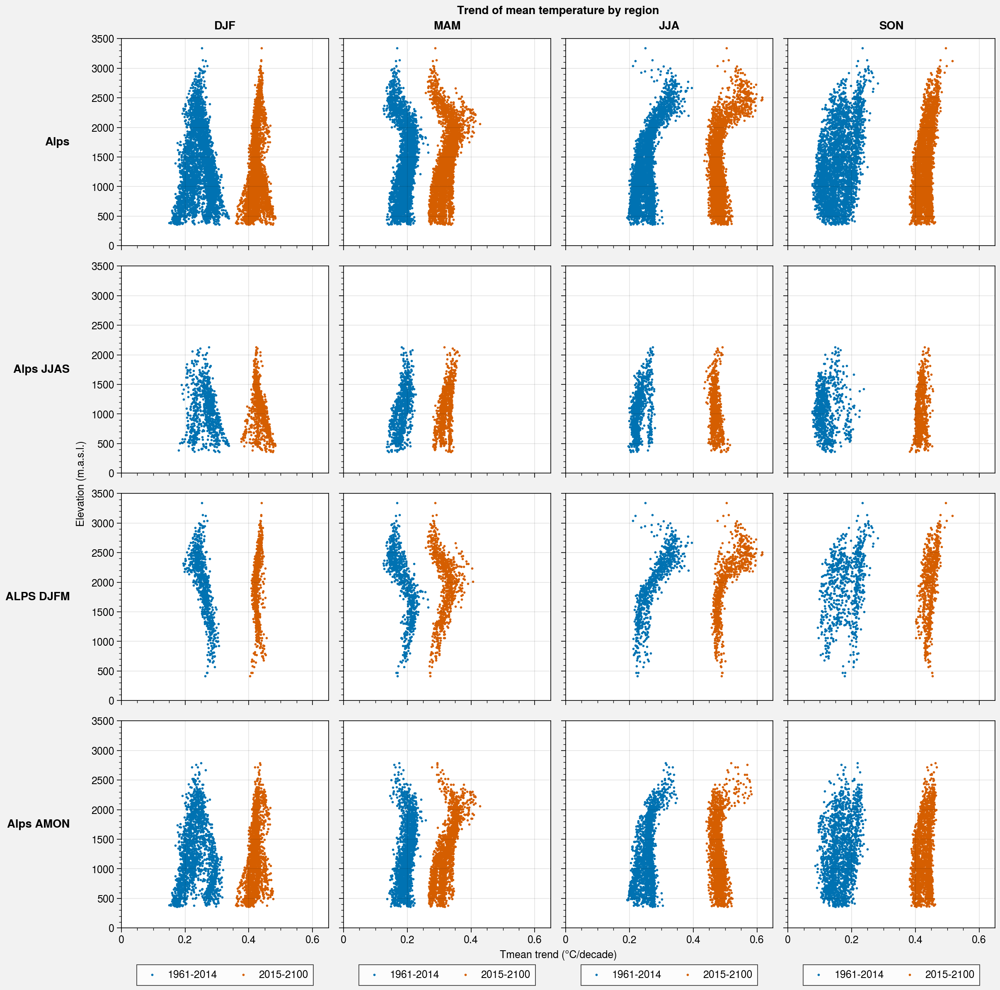

In [13]:
f, axs = pplt.subplots(ncols=4, nrows=4)
leg = ['1961-2014','2015-2100']

for i in range(4):
    slope_T_hist_0 = np.ma.masked_array(slope_T_hist[i], mask=np.invert(region_masks[0]))
    slope_T_hist_1 = np.ma.masked_array(slope_T_hist[i], mask=np.invert(region_masks[1]))
    slope_T_hist_2 = np.ma.masked_array(slope_T_hist[i], mask=np.invert(region_masks[2]))
    slope_T_hist_3 = np.ma.masked_array(slope_T_hist[i], mask=np.invert(region_masks[3]))
    slopes=[slope_T_hist_0,slope_T_hist_1,slope_T_hist_2,slope_T_hist_3]
    
    for j,slope in enumerate(slopes):
        ax = axs[i+4*j]
        blue_dot = ax.scatter(10*slope,ds.SH[jmin:jmax,imin:imax],s=2)
        
    
for i in range(4):
    slope_T_fut_0 = np.ma.masked_array(slope_T_fut[i], mask=np.invert(region_masks[0]))
    slope_T_fut_1 = np.ma.masked_array(slope_T_fut[i], mask=np.invert(region_masks[1]))
    slope_T_fut_2 = np.ma.masked_array(slope_T_fut[i], mask=np.invert(region_masks[2]))
    slope_T_fut_3 = np.ma.masked_array(slope_T_fut[i], mask=np.invert(region_masks[3]))
    slopes=[slope_T_fut_0,slope_T_fut_1,slope_T_fut_2,slope_T_fut_3]
    
    for j,slope in enumerate(slopes):
        ax = axs[i+4*j]
        orange_dot = ax.scatter(10*slope,ds.SH[jmin:jmax,imin:imax],s=2)
        ax.set_xlim((0.,0.65))
        ax.set_ylim((0.,3500))
        if(j==3):
            ax.legend([blue_dot,orange_dot],leg,loc='bottom')

axs.format(suptitle='Trend of mean temperature by region',collabels=['DJF','MAM','JJA', 'SON'],
           rowlabels=names_regions,xlabel='Tmean trend (°C/decade)',ylabel='Elevation (m.a.s.l.)')

In [14]:
slope_T_periods = np.load('/bettik/castelli/data/saved_data_MAR_ECEarth3/slope_T_50yearperiods.npy')

#### Visualizing the periods data

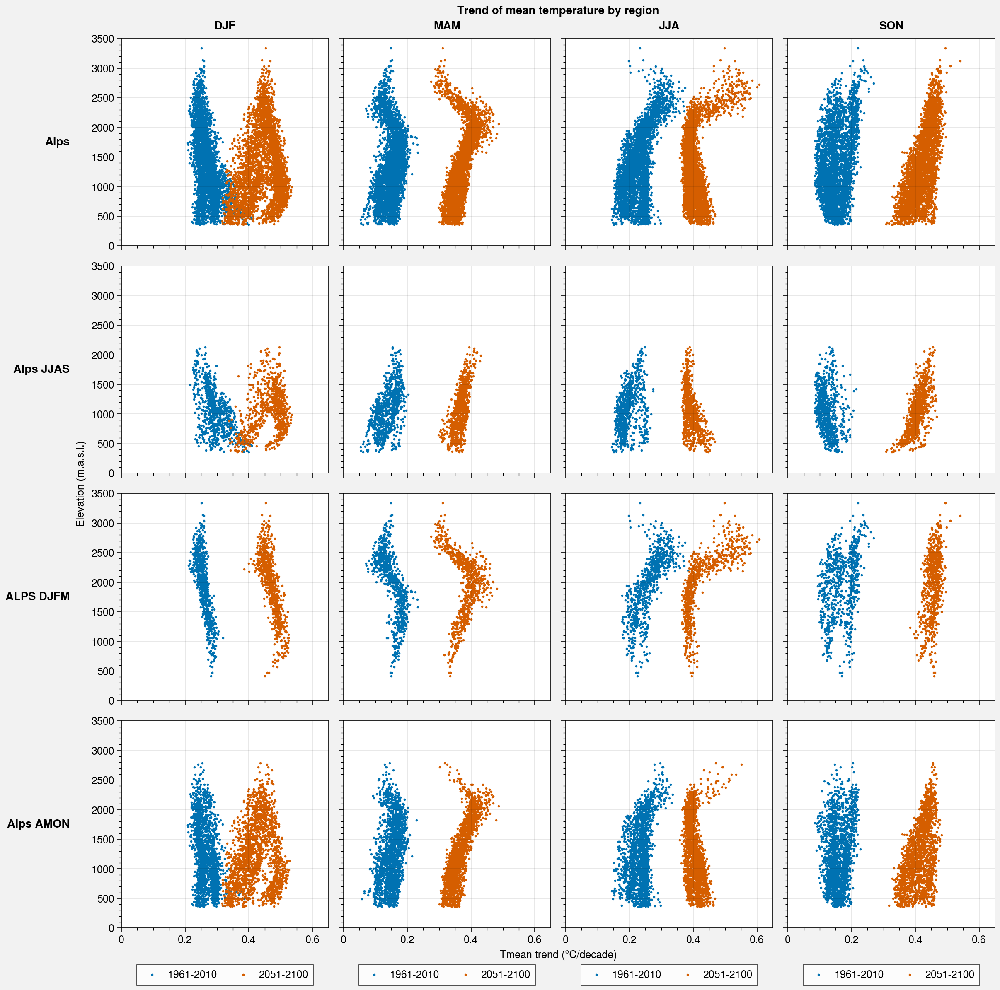

In [16]:
f, axs = pplt.subplots(ncols=4, nrows=4)
leg = ['1961-2010','2051-2100']

for i in range(4):
    slope_T_hist_0 = np.ma.masked_array(slope_T_periods[0,i], mask=np.invert(region_masks[0]))
    slope_T_hist_1 = np.ma.masked_array(slope_T_periods[0,i], mask=np.invert(region_masks[1]))
    slope_T_hist_2 = np.ma.masked_array(slope_T_periods[0,i], mask=np.invert(region_masks[2]))
    slope_T_hist_3 = np.ma.masked_array(slope_T_periods[0,i], mask=np.invert(region_masks[3]))
    slopes=[slope_T_hist_0,slope_T_hist_1,slope_T_hist_2,slope_T_hist_3]
    
    for j,slope in enumerate(slopes):
        ax = axs[i+4*j]
        blue_dot = ax.scatter(10*slope,ds.SH[jmin:jmax,imin:imax],s=2)
        
    
for i in range(4):
    slope_T_fut_0 = np.ma.masked_array(slope_T_periods[-1,i], mask=np.invert(region_masks[0]))
    slope_T_fut_1 = np.ma.masked_array(slope_T_periods[-1,i], mask=np.invert(region_masks[1]))
    slope_T_fut_2 = np.ma.masked_array(slope_T_periods[-1,i], mask=np.invert(region_masks[2]))
    slope_T_fut_3 = np.ma.masked_array(slope_T_periods[-1,i], mask=np.invert(region_masks[3]))
    slopes=[slope_T_fut_0,slope_T_fut_1,slope_T_fut_2,slope_T_fut_3]
    
    for j,slope in enumerate(slopes):
        ax = axs[i+4*j]
        orange_dot = ax.scatter(10*slope,ds.SH[jmin:jmax,imin:imax],s=2)
        ax.set_xlim((0.,0.65))
        ax.set_ylim((0.,3500))
        if(j==3):
            ax.legend([blue_dot,orange_dot],leg,loc='bottom')

axs.format(suptitle='Trend of mean temperature by region',collabels=['DJF','MAM','JJA', 'SON'],
           rowlabels=names_regions,xlabel='Tmean trend (°C/decade)',ylabel='Elevation (m.a.s.l.)')

In [20]:
knot_numbers = 9
height_new = np.linspace(0, 1, knot_numbers+2)[1:-1]


height_max = np.full((5,90),np.nan) # 4 regions, 90 periods

for region in range(4):
    height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[region]))
    vec_height = height[height.mask == False]
    for i in range(90):
        slope_T_MAM = 10*np.ma.masked_array(slope_T_periods[i,1], mask=np.invert(region_masks[region]))
        vec_slope_T_MAM = slope_T_MAM[slope_T_MAM.mask == False]
        
        vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]
        vec_slope_T_MAM_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]
        
        q_knots = np.quantile(vec_height_srt, height_new)
        
        t,c,k = interpolate.splrep(vec_height_srt, vec_slope_T_MAM_srt, t=q_knots, s=1)
        yfit = interpolate.BSpline(t,c,k)(vec_height_srt)
        
        #if(region==2):
        #    height_max[region,i] = vec_height_srt[np.argmax(yfit[100:-50])]
        #elif(region==4):
        #    height_max[region,i] = vec_height_srt[np.argmax(yfit[100:-100])]
        #else:
        height_max[region,i] = vec_height_srt[np.argmax(yfit)]
        
    print(yfit.shape)

(3556,)
(868,)
(789,)
(1899,)


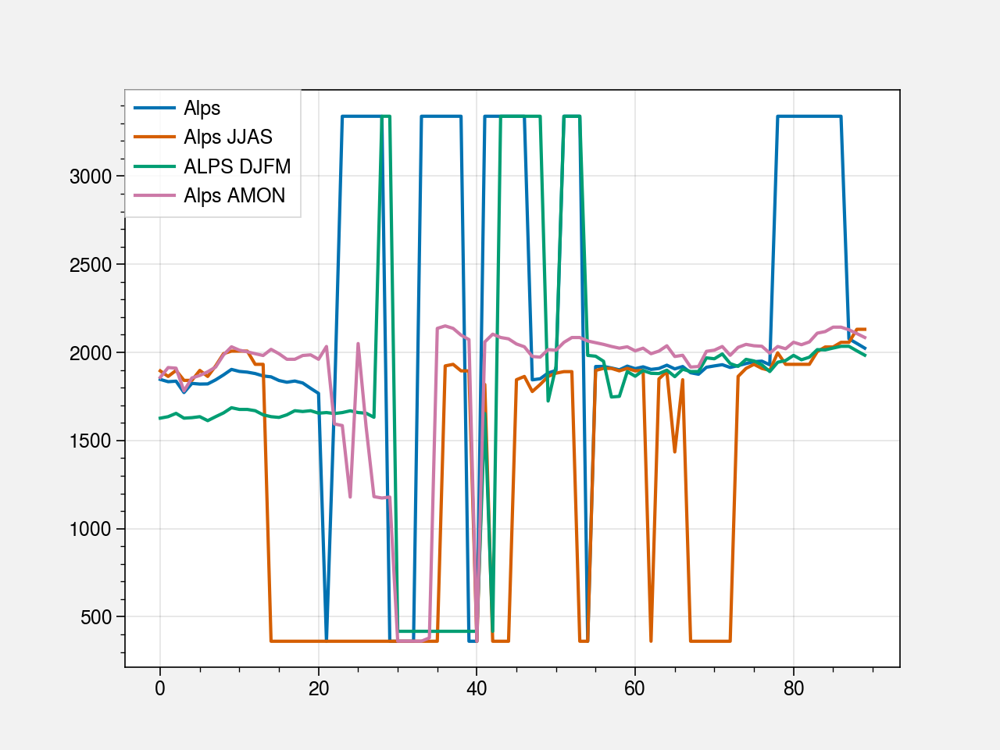

In [22]:
for i in range(4):
    plt.plot(height_max[i],label=names_regions[i])

plt.legend()

#### Modified

In [15]:
knot_numbers = 9
height_new = np.linspace(0, 1, knot_numbers+2)[1:-1]


height_max = np.full((5,90),np.nan) # 4 regions, 90 periods

for region in range(4):
    height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[region]))
    vec_height = height[height.mask == False]
    for i in range(90):
        slope_T_MAM = 10*np.ma.masked_array(slope_T_periods[i,1], mask=np.invert(region_masks[region]))
        vec_slope_T_MAM = slope_T_MAM[slope_T_MAM.mask == False]
        
        vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]
        vec_slope_T_MAM_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]
        
        q_knots = np.quantile(vec_height_srt, height_new)
        
        t,c,k = interpolate.splrep(vec_height_srt, vec_slope_T_MAM_srt, t=q_knots, s=1)
        yfit = interpolate.BSpline(t,c,k)(vec_height_srt)
        
        if(region==0):
            height_max[region,i] = vec_height_srt[np.argmax(yfit[100:-100])]
        elif(region==1):
            height_max[region,i] = vec_height_srt[np.argmax(yfit[50:])]
        elif(region==2):
            height_max[region,i] = vec_height_srt[np.argmax(yfit[100:-100])]
        elif(region==3):
            height_max[region,i] = vec_height_srt[np.argmax(yfit[100:-100])]
        
    print(yfit.shape)

(3556,)
(868,)
(789,)
(1899,)


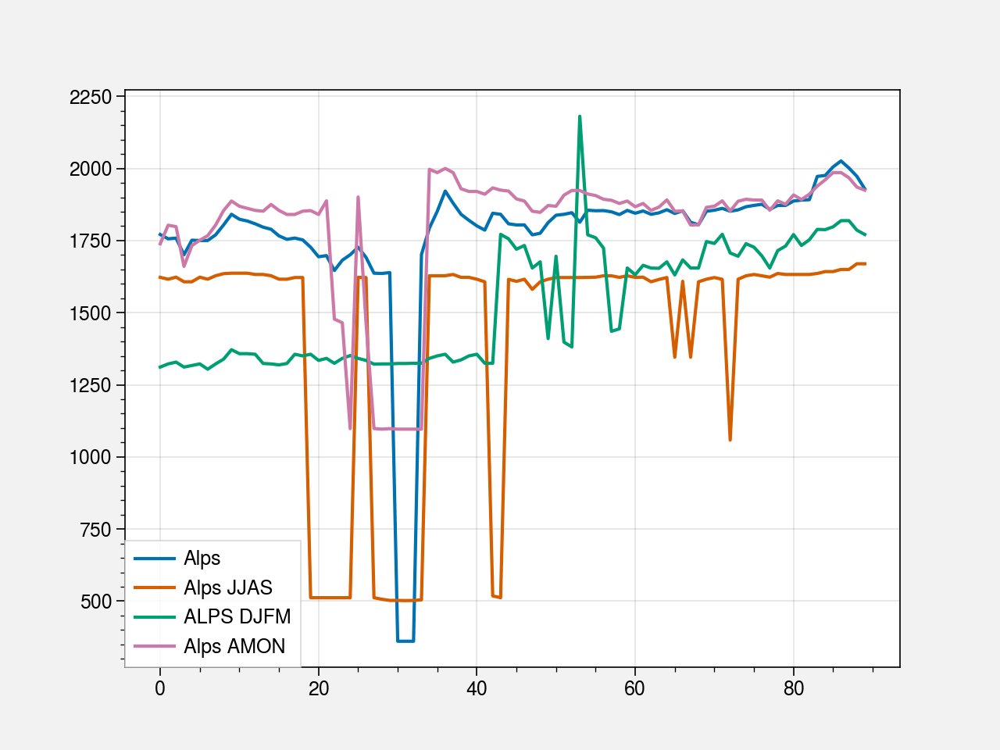

In [16]:
for i in range(4):
    plt.plot(height_max[i],label=names_regions[i])

plt.legend()

### "Simple" regions

In [6]:
ne_alps = np.copy(alps) # ne : north-east
ne_alps[lat<46.7] = False


nw_alps2 = np.copy(alps) # nw : north-west
nw_alps2[lon>7.9] = False
nw_alps2[lat<45.9] = False
nw_alps2[lat>46.7] = False

nw_alps3 = np.copy(alps) # nw : north-west
nw_alps3[lon>6.9] = False
nw_alps3[lat<44.8] = False
nw_alps3[lat>46.7] = False

nw_alps4 = np.copy(alps) # nw : north-west
nw_alps4[lon>8.3] = False
nw_alps4[lat<46.4] = False
nw_alps4[lat>46.7] = False

nw_alps5 = np.copy(alps) # nw : north-west
nw_alps5[lon>7.1] = False
nw_alps5[lat<45.2] = False
nw_alps5[lat>46.7] = False

nw_alps = np.logical_or(np.logical_or(np.logical_or(nw_alps2,nw_alps3),nw_alps4),nw_alps5)


s_alps = np.logical_and(alps,np.invert(np.logical_or(nw_alps,ne_alps)))

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


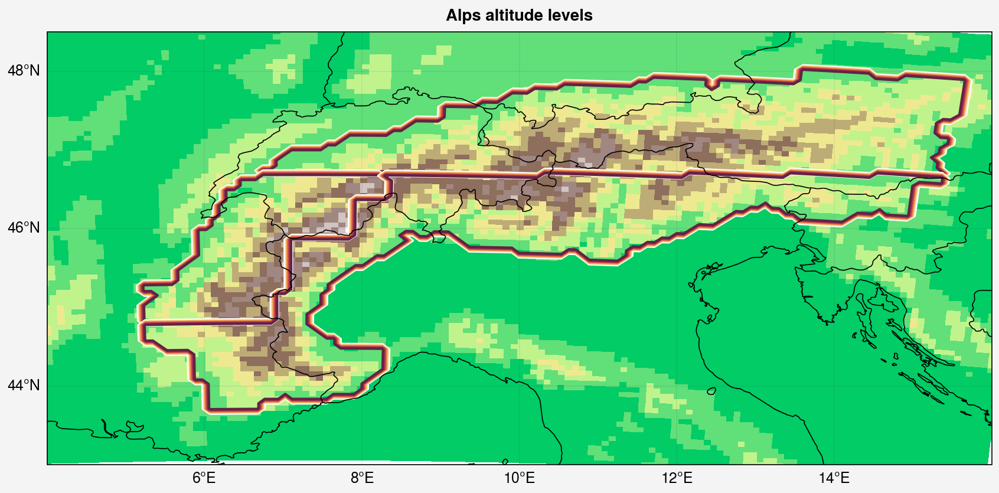

In [7]:
f, ax = pplt.subplots(proj='cyl', axwidth=8)

#H_east_alps = np.ma.masked_array(H, mask=np.invert(east_alps))

ax.pcolormesh(lon, lat,H,edgecolors='none',cmap=colors_land)
ax.contour(lon, lat,ne_alps)
ax.contour(lon, lat,nw_alps)
ax.contour(lon, lat,s_alps)
ax.format(**normal_format,suptitle='Alps altitude levels')

In [7]:
region_masks = [alps,ne_alps,nw_alps,s_alps]
names_regions = ['Alps','Alps NE','Alps NW','Alps S']

In [8]:
def plot_4reg_4seas(Slope_hist,Slope_fut,Xlim,Suptitle,Xlabel):
    f, axs = pplt.subplots(ncols=4, nrows=4)
    leg = ['1961-2014','2015-2100']
    
    for i in range(4):
        slope_hist_alps = np.ma.masked_array(Slope_hist[i], mask=np.invert(alps))
        slope_hist_ne_alps = np.ma.masked_array(Slope_hist[i], mask=np.invert(ne_alps))
        slope_hist_nw_alps = np.ma.masked_array(Slope_hist[i], mask=np.invert(nw_alps))
        slope_hist_s_alps = np.ma.masked_array(Slope_hist[i], mask=np.invert(s_alps))
        slopes=[slope_hist_alps,slope_hist_ne_alps,slope_hist_nw_alps,slope_hist_s_alps]
        
        for j,slope in enumerate(slopes):
            ax = axs[i+4*j]
            hist_dots = ax.scatter(10*slope.flatten(),H.flatten(),s=2,label=leg[0])
        
    
    for i in range(4):
        slope_fut_alps = np.ma.masked_array(Slope_fut[i], mask=np.invert(alps))
        slope_fut_ne_alps = np.ma.masked_array(Slope_fut[i], mask=np.invert(ne_alps))
        slope_fut_nw_alps = np.ma.masked_array(Slope_fut[i], mask=np.invert(nw_alps))
        slope_fut_s_alps = np.ma.masked_array(Slope_fut[i], mask=np.invert(s_alps))
        slopes=[slope_fut_alps,slope_fut_ne_alps,slope_fut_nw_alps,slope_fut_s_alps]
        
        for j,slope in enumerate(slopes):
            ax = axs[i+4*j]
            fut_dots = ax.scatter(10*slope.flatten(),H.flatten(),s=2,label=leg[1])
            ax.set_xlim(Xlim)
            ax.set_ylim((0.,3500))
            #if(j==3):
            #    ax.legend([blue_dot,orange_dot],leg,loc='bottom')
    
    axs.format(suptitle=Suptitle,collabels=['DJF','MAM','JJA', 'SON'],
           rowlabels=['Alps','NE Alps','NW Alps','Southern Alps'],xlabel=Xlabel,ylabel='Elevation (m.a.s.l.)')
    f.legend([hist_dots,fut_dots],loc='bottom')

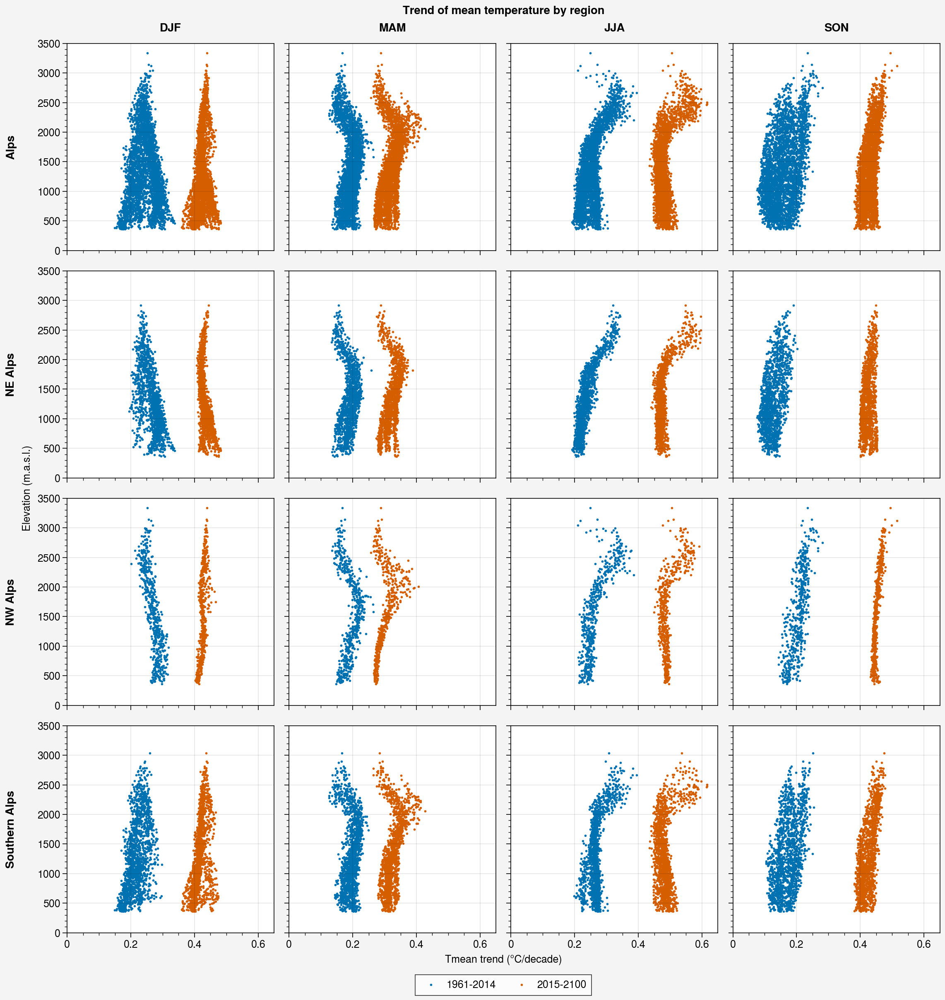

In [10]:
plot_4reg_4seas(slope_T_hist,slope_T_fut,Xlim=(0.,0.65),Suptitle='Trend of mean temperature by region',Xlabel='Tmean trend (°C/decade)')

In [9]:
slope_T_periods = np.load('/bettik/castelli/data/saved_data_MAR_ECEarth3/slope_T_50yearperiods.npy')

In [10]:
slope_T_periods.shape

(90, 4, 91, 139)

In [11]:
from scipy.ndimage import uniform_filter1d

def rolling_mean_along_axis(a, W, axis=-1):
    # a : Input ndarray
    # W : Window size
    # axis : Axis along which we will apply rolling/sliding mean
    hW = W//2
    L = a.shape[axis]-W+1   
    indexer = [slice(None) for _ in range(a.ndim)]
    indexer[axis] = slice(hW,hW+L)
    return uniform_filter1d(a,W,axis=axis)[tuple(indexer)]

In [12]:
def spline_fit_4reg(period_slopes,N_seas,knot_numbers,yfitminpercent=10,yfitmaxpercent=5):

    height_new = np.linspace(0, 1, knot_numbers+2)[1:-1]
    height_max = np.full((4,90),np.nan) # 4 regions, 90 periods
    value_max = np.full((4,90),np.nan) # 4 regions, 90 periods

    Nperiods = period_slopes.shape[0]
    
    for region in range(4):
        height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[region]))
        vec_height = height[height.mask == False]
        for i in range(Nperiods):
            slope_T_seas = 10*np.ma.masked_array(period_slopes[i,N_seas], mask=np.invert(region_masks[region]))
            vec_slope_T_seas = slope_T_seas[slope_T_seas.mask == False]
            
            vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_seas), key=lambda pair: pair[0])]
            vec_slope_T_seas_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_seas), key=lambda pair: pair[0])]
            
            q_knots = np.quantile(vec_height_srt, height_new)
            
            t,c,k = interpolate.splrep(vec_height_srt, vec_slope_T_seas_srt, t=q_knots, s=1)
            yfit = interpolate.BSpline(t,c,k)(vec_height_srt)
            
            yfitmin = int(yfitminpercent/100*len(yfit))
            yfitmax = int(yfitmaxpercent/100*len(yfit))
            vec_height_srt_redux = vec_height_srt[yfitmin:-yfitmax]
            height_max[region,i] = vec_height_srt_redux[np.argmax(yfit[yfitmin:-yfitmax])]
            value_max[region,i] = np.max(yfit[yfitmin:-yfitmax])

        print(yfitmin, " ",yfitmax,end=" ")
        print(yfit.shape)
    
    return height_max, value_max

In [13]:
rollmean5_slope_T_periods = rolling_mean_along_axis(slope_T_periods, 5, axis=0)

rollmean5_slope_T_periods.shape

(86, 4, 91, 139)

In [14]:
rollmean10_slope_T_periods = rolling_mean_along_axis(slope_T_periods, 10, axis=0)

rollmean10_slope_T_periods.shape

(81, 4, 91, 139)

In [15]:
slope_T_periods.shape

(90, 4, 91, 139)

In [11]:
height_max_k9_MAM, value_max_k9_MAM = spline_fit_4reg(slope_T_periods,1,9,yfitminpercent=20,yfitmaxpercent=3)

711   106 (3556,)
294   44 (1471,)
109   16 (546,)
307   46 (1539,)


In [17]:
height_max_k9_MAM_rollmean5 = spline_fit_4reg(rollmean5_slope_T_periods,1,9,yfitminpercent=20,yfitmaxpercent=3)

711   106 (3556,)
294   44 (1471,)
109   16 (546,)
307   46 (1539,)


In [18]:
height_max_k9_MAM_rollmean10 = spline_fit_4reg(rollmean10_slope_T_periods,1,9,yfitminpercent=20,yfitmaxpercent=3)

711   106 (3556,)
294   44 (1471,)
109   16 (546,)
307   46 (1539,)


#### Saving data for sending to Juliette

In [71]:
vec_height_sorted_alps = np.empty(shape=(90, 3556))
vec_slopeT_MAM_sorted_alps = np.empty(shape=(90, 3556))

vec_height_sorted_alps_ne = np.empty(shape=(90, 1471))
vec_slopeT_MAM_sorted_alps_ne = np.empty(shape=(90, 1471))

vec_height_sorted_alps_nw = np.empty(shape=(90, 546))
vec_slopeT_MAM_sorted_alps_nw = np.empty(shape=(90, 546))

vec_height_sorted_alps_s = np.empty(shape=(90, 1539))
vec_slopeT_MAM_sorted_alps_s = np.empty(shape=(90, 1539))

for region in range(4):
    height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[region]))
    vec_height = height[height.mask == False]
    for i in range(90):
        slope_T_MAM = 10*np.ma.masked_array(slope_T_periods[i,1], mask=np.invert(region_masks[region]))
        vec_slope_T_MAM = slope_T_MAM[slope_T_MAM.mask == False]
        
        vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]
        vec_slope_T_MAM_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]

        if region == 0:
            vec_height_sorted_alps[i] = vec_height_srt
            vec_slopeT_MAM_sorted_alps[i] = vec_slope_T_MAM_srt
        if region == 1:
            vec_height_sorted_alps_ne[i] = vec_height_srt
            vec_slopeT_MAM_sorted_alps_ne[i] = vec_slope_T_MAM_srt
        if region == 2:
            vec_height_sorted_alps_nw[i] = vec_height_srt
            vec_slopeT_MAM_sorted_alps_nw[i] = vec_slope_T_MAM_srt
        if region == 3:
            vec_height_sorted_alps_s[i] = vec_height_srt
            vec_slopeT_MAM_sorted_alps_s[i] = vec_slope_T_MAM_srt

In [72]:
np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_height_sorted_alps.txt',vec_height_sorted_alps)
np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_slopeT_MAM_sorted_alps.txt',vec_slopeT_MAM_sorted_alps)

np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_height_sorted_alps_ne.txt',vec_height_sorted_alps_ne)
np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_slopeT_MAM_sorted_alps_ne.txt',vec_slopeT_MAM_sorted_alps_ne)

np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_height_sorted_alps_nw.txt',vec_height_sorted_alps_nw)
np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_slopeT_MAM_sorted_alps_nw.txt',vec_slopeT_MAM_sorted_alps_nw)

np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_height_sorted_alps_s.txt',vec_height_sorted_alps_s)
np.savetxt('/bettik/castelli/data/saved_data_MAR_ECEarth3/txt/vec_slopeT_MAM_sorted_alps_s.txt',vec_slopeT_MAM_sorted_alps_s)

#### Back

In [14]:
# No exclusion, 9, 5 and 3 knots

height_max_k9_MAM_norestrict, value_max_k9_MAM_norestrict = spline_fit_4reg(slope_T_periods,1,9,yfitminpercent=0,yfitmaxpercent=0.2)
height_max_k5_MAM_norestrict, value_max_k5_MAM_norestrict = spline_fit_4reg(slope_T_periods,1,5,yfitminpercent=0,yfitmaxpercent=0.2)
height_max_k3_MAM_norestrict, value_max_k3_MAM_norestrict = spline_fit_4reg(slope_T_periods,1,3,yfitminpercent=0,yfitmaxpercent=0.2)

0   7 (3556,)
0   2 (1471,)
0   1 (546,)
0   3 (1539,)
0   7 (3556,)
0   2 (1471,)
0   1 (546,)
0   3 (1539,)
0   7 (3556,)
0   2 (1471,)
0   1 (546,)
0   3 (1539,)


Text(0.5, 1.0, '3 knots')

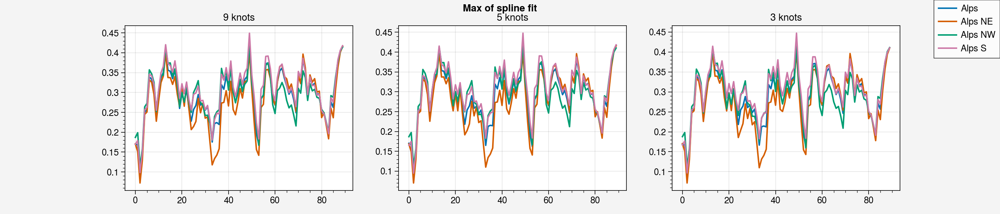

In [15]:
ig, ax = plt.subplots(ncols=3, figsize=(14, 3))

for i in range(4):
    ax[0].plot(value_max_k9_MAM_norestrict[i],label=names_regions[i])
    #ax[0].set_ylim([1300,2200])
    ax[1].plot(value_max_k5_MAM_norestrict[i])
    #ax[1].set_ylim([1300,2200])
    ax[2].plot(value_max_k3_MAM_norestrict[i])
    #ax[2].set_ylim([1300,2200])

ig.legend()
ig.suptitle('Max of spline fit')
ax[0].set_title('9 knots')
ax[1].set_title('5 knots')
ax[2].set_title('3 knots')

Text(0.5, 1.0, '3 knots')

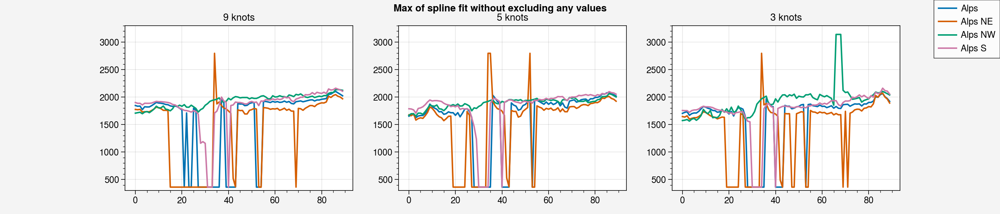

In [32]:
ig, ax = plt.subplots(ncols=3, figsize=(14, 3))

for i in range(4):
    ax[0].plot(height_max_k9_MAM_norestrict[i],label=names_regions[i])
    ax[0].set_ylim([300,3300])
    ax[1].plot(height_max_k5_MAM_norestrict[i])
    ax[1].set_ylim([300,3300])
    ax[2].plot(height_max_k3_MAM_norestrict[i])
    ax[2].set_ylim([300,3300])

ig.legend()
ig.suptitle('Max of spline fit without excluding any values')
ax[0].set_title('9 knots')
ax[1].set_title('5 knots')
ax[2].set_title('3 knots')

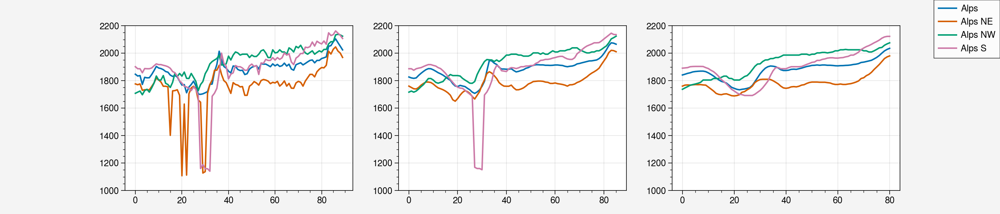

In [33]:
ig, ax = plt.subplots(ncols=3, figsize=(14, 3))

for i in range(4):
    ax[0].plot(height_max_k9_MAM[i],label=names_regions[i])
    ax[0].set_ylim([1000,2200])
    ax[1].plot(height_max_k9_MAM_rollmean5[i])
    ax[1].set_ylim([1000,2200])
    ax[2].plot(height_max_k9_MAM_rollmean10[i])
    ax[2].set_ylim([1000,2200])

ig.legend()

In [19]:
height_max_k5_MAM, value_max_k5_MAM = spline_fit_4reg(slope_T_periods,1,5,yfitminpercent=20,yfitmaxpercent=3)
#height_max_k5_MAM_rollmean5 = spline_fit_4reg(rollmean5_slope_T_periods,1,5,yfitminpercent=20,yfitmaxpercent=3)

711   106 (3556,)
294   44 (1471,)
109   16 (546,)
307   46 (1539,)


In [35]:
height_max_k5_MAM_rollmean10 = spline_fit_4reg(rollmean10_slope_T_periods,1,5,yfitminpercent=20,yfitmaxpercent=3)

711   106 (3556,)
294   44 (1471,)
109   16 (546,)
307   46 (1539,)


Text(0.5, 0.98, '5 knots')

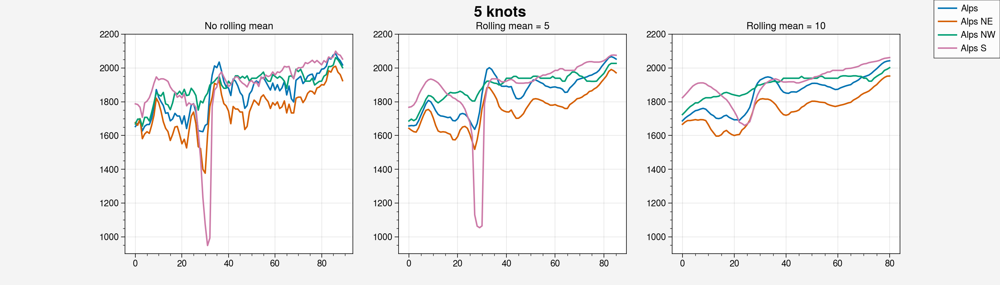

In [36]:
ig, ax = plt.subplots(ncols=3, figsize=(14, 4))

for i in range(4):
    ax[0].plot(height_max_k5_MAM[i],label=names_regions[i])
    ax[0].set_ylim([900,2200])
    ax[1].plot(height_max_k5_MAM_rollmean5[i])
    ax[1].set_ylim([900,2200])
    ax[2].plot(height_max_k5_MAM_rollmean10[i])
    ax[2].set_ylim([900,2200])

ax[0].set_title('No rolling mean')
ax[1].set_title('Rolling mean = 5')
ax[2].set_title('Rolling mean = 10')
ig.legend()
ig.suptitle('5 knots',fontsize=15)

In [20]:
height_max_k3_MAM, value_max_k3_MAM = spline_fit_4reg(slope_T_periods,1,3,yfitminpercent=20,yfitmaxpercent=3)
#height_max_k3_MAM_rollmean5 = spline_fit_4reg(rollmean5_slope_T_periods,1,3,yfitminpercent=20,yfitmaxpercent=3)

711   106 (3556,)
294   44 (1471,)
109   16 (546,)
307   46 (1539,)


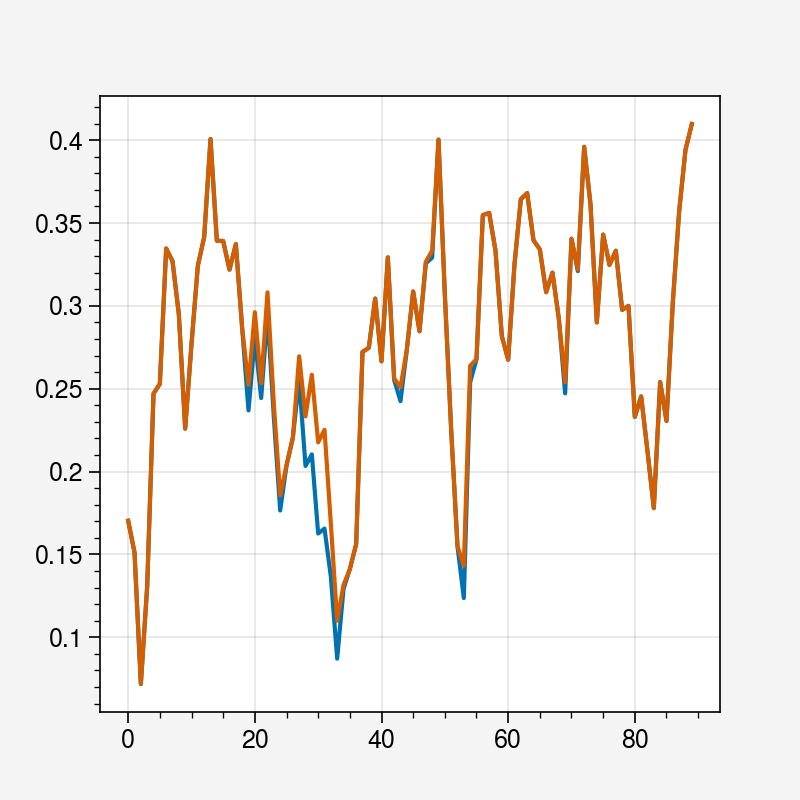

In [26]:
plt.plot(value_max_k3_MAM[1])
plt.plot(value_max_k3_MAM_norestrict[1])

Text(0.5, 1.0, '3 knots')

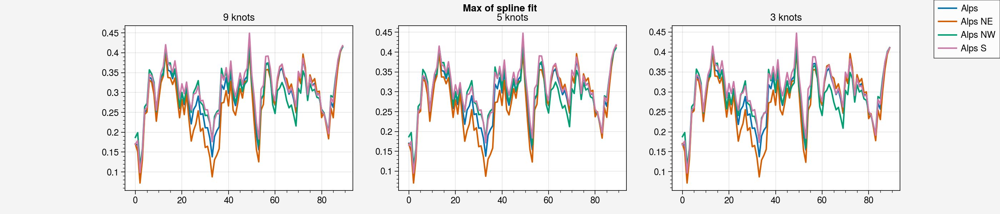

In [21]:
ig, ax = plt.subplots(ncols=3, figsize=(14, 3))

for i in range(4):
    ax[0].plot(value_max_k9_MAM[i],label=names_regions[i])
    #ax[0].set_ylim([1300,2200])
    ax[1].plot(value_max_k5_MAM[i])
    #ax[1].set_ylim([1300,2200])
    ax[2].plot(value_max_k3_MAM[i])
    #ax[2].set_ylim([1300,2200])

ig.legend()
ig.suptitle('Max of spline fit')
ax[0].set_title('9 knots')
ax[1].set_title('5 knots')
ax[2].set_title('3 knots')

In [38]:
height_max_k3_MAM_rollmean10 = spline_fit_4reg(rollmean10_slope_T_periods,1,3,yfitminpercent=20,yfitmaxpercent=3)

711   106 (3556,)
294   44 (1471,)
109   16 (546,)
307   46 (1539,)


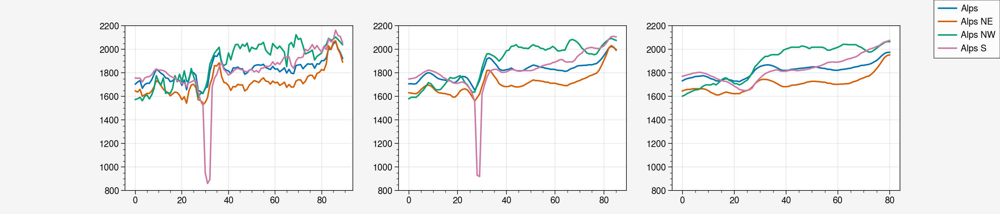

In [39]:
ig, ax = plt.subplots(ncols=3, figsize=(14, 3))

for i in range(4):
    ax[0].plot(height_max_k3_MAM[i],label=names_regions[i])
    ax[0].set_ylim([800,2200])
    ax[1].plot(height_max_k3_MAM_rollmean5[i])
    ax[1].set_ylim([800,2200])
    ax[2].plot(height_max_k3_MAM_rollmean10[i])
    ax[2].set_ylim([800,2200])

ig.legend()

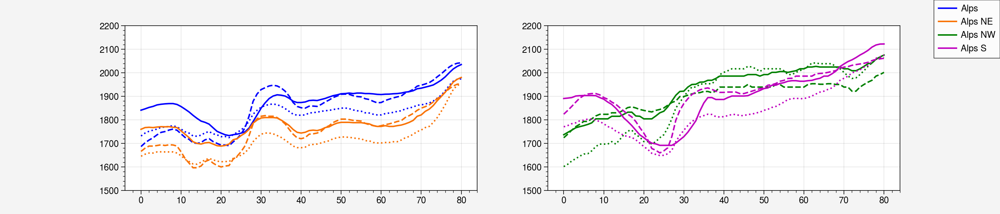

In [104]:
colors=['b','orange','g','m']

ig, ax = plt.subplots(ncols=2, figsize=(14, 3))

for i in [0,1]:
    ax[0].plot(height_max_k9_MAM_rollmean10[i],label=names_regions[i],c=colors[i])
    ax[0].plot(height_max_k5_MAM_rollmean10[i],linestyle='--',c=colors[i])
    ax[0].plot(height_max_k3_MAM_rollmean10[i],linestyle=':',c=colors[i])
ax[0].set_ylim([1500,2200])

for i in [2,3]:
    ax[1].plot(height_max_k9_MAM_rollmean10[i],label=names_regions[i],c=colors[i])
    ax[1].plot(height_max_k5_MAM_rollmean10[i],linestyle='--',c=colors[i])
    ax[1].plot(height_max_k3_MAM_rollmean10[i],linestyle=':',c=colors[i])
ax[1].set_ylim([1500,2200])

ig.legend()


In [16]:
def spline(knots, x, y):
    x_new = np.linspace(0, 1, knots+2)[1:-1]
    q_knots = np.quantile(x, x_new)
    t, c, k = interpolate.splrep(x, y, t=q_knots)
    yfit = interpolate.BSpline(t,c, k)(x)
    return yfit

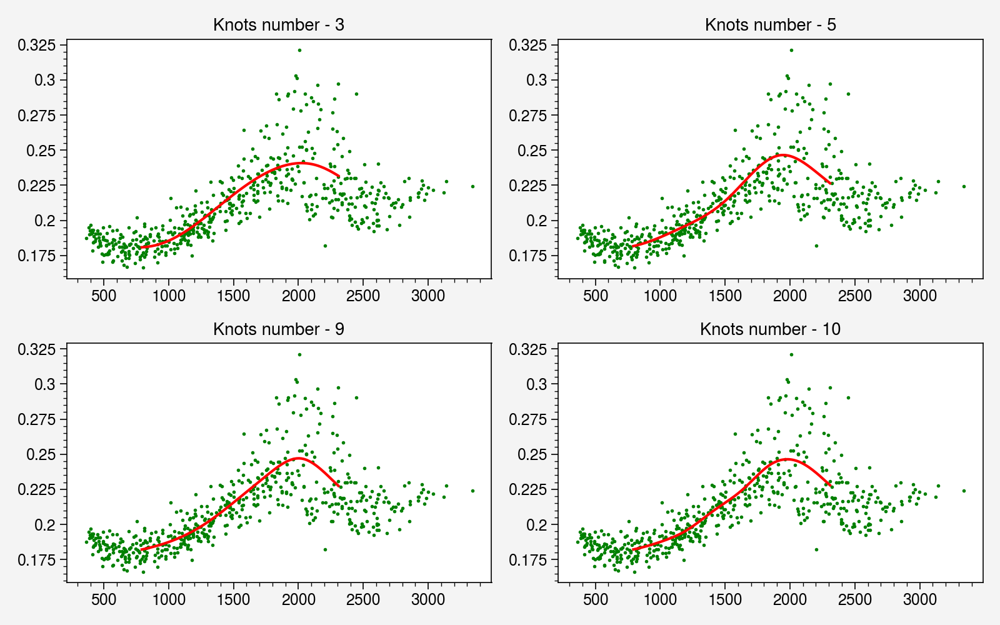

In [17]:
i=60

height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[2]))
vec_height = height[height.mask == False]

slope_T_MAM = 10*np.ma.masked_array(slope_T_periods[i,1], mask=np.invert(region_masks[2]))
vec_slope_T_MAM = slope_T_MAM[slope_T_MAM.mask == False]
        
vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]
vec_slope_T_MAM_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]


knots = [3, 5, 9, 10]
i = 0

ig, ax = plt.subplots(nrows=2, ncols=2, figsize=(8, 5))

for row in range(2):
    for col in range(2):
        ax[row][col].plot(vec_height_srt, vec_slope_T_MAM_srt, '.',c="g", markersize=2)
        yfit = spline(knots[i],vec_height_srt, vec_slope_T_MAM_srt)
        ax[row][col].plot(vec_height_srt[100:-100], yfit[100:-100], 'r')
        ax[row][col].set_title("Knots number - "+str(knots[i]))
        ax[row][col].grid()
        i=i+1
        
plt.tight_layout()        
plt.show()

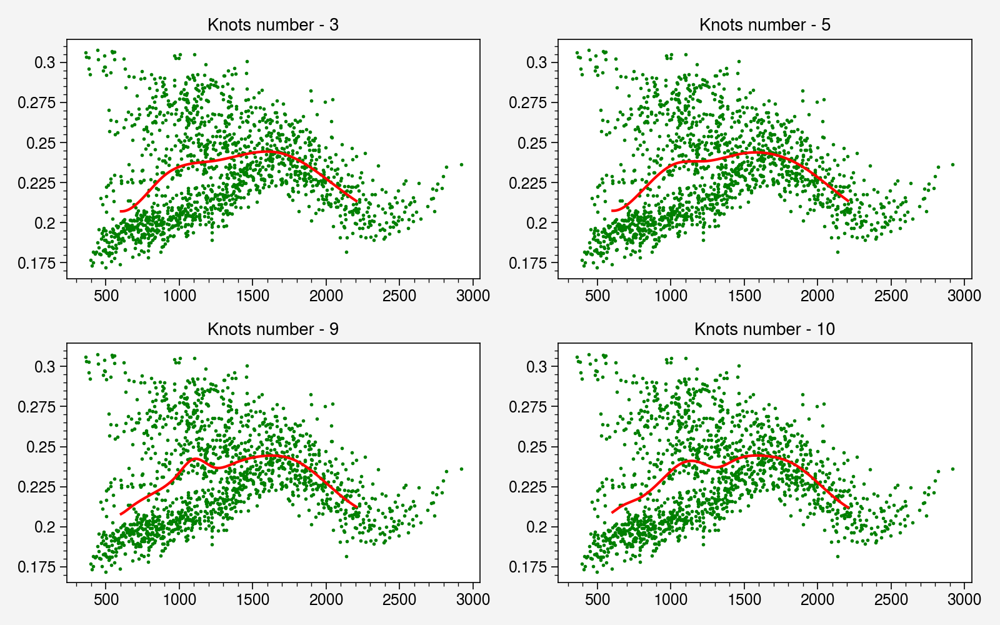

In [18]:
i=21

height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[1]))
vec_height = height[height.mask == False]

slope_T_MAM = 10*np.ma.masked_array(slope_T_periods[i,1], mask=np.invert(region_masks[1]))
vec_slope_T_MAM = slope_T_MAM[slope_T_MAM.mask == False]
        
vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]
vec_slope_T_MAM_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_MAM), key=lambda pair: pair[0])]


knots = [3, 5, 9, 10]
i = 0

ig, ax = plt.subplots(nrows=2, ncols=2, figsize=(8, 5))

for row in range(2):
    for col in range(2):
        ax[row][col].plot(vec_height_srt, vec_slope_T_MAM_srt, '.',c="g", markersize=2)
        yfit = spline(knots[i],vec_height_srt, vec_slope_T_MAM_srt)
        ax[row][col].plot(vec_height_srt[100:-100], yfit[100:-100], 'r')
        ax[row][col].set_title("Knots number - "+str(knots[i]))
        ax[row][col].grid()
        i=i+1
        
plt.tight_layout()        
plt.show()

### Snow

In [13]:
def find_snowline(first_year,last_year,mm_snow_thresh,N):
    
    minH_snow = np.zeros((4,(last_year-first_year+1),365))
    maxH_nosnow = np.zeros((4,(last_year-first_year+1),365))

    for year in list(range(first_year,last_year+1)):
        print(year,end=' ')
        if year <2015:
            ds_snow = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/HIST/daily/ICE.EC-Earth3_HIST.EUe.MB.'+str(year)+'.nc')
        else:
            ds_snow = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/SSP245/daily/ICE.EC-Earth3_SSP245.EUe.MB.'+str(year)+'.nc')
        
        array_snow = ds_snow.MB.max(axis=1)[:,jmin:jmax,imin:imax]
        nb_days = array_snow.shape[0]
        where_snow = (array_snow > mm_snow_thresh)
        
        where_snowalps = np.logical_and(where_snow, np.repeat(alps[np.newaxis,:,:],nb_days,axis=0))
        where_snowalps_ne = np.logical_and(where_snow, np.repeat(ne_alps[np.newaxis,:,:],nb_days,axis=0))
        where_snowalps_nw = np.logical_and(where_snow, np.repeat(nw_alps[np.newaxis,:,:],nb_days,axis=0))
        where_snowalps_s = np.logical_and(where_snow, np.repeat(s_alps[np.newaxis,:,:],nb_days,axis=0))
        where_snowall = [where_snowalps,where_snowalps_ne,where_snowalps_nw,where_snowalps_s]
        
        where_no_snow = (array_snow < mm_snow_thresh)
        
        where_no_snowalps = np.logical_and(where_no_snow, np.repeat(alps[np.newaxis,:,:],nb_days,axis=0))
        where_no_snowalps_ne = np.logical_and(where_no_snow, np.repeat(ne_alps[np.newaxis,:,:],nb_days,axis=0))
        where_no_snowalps_nw = np.logical_and(where_no_snow, np.repeat(nw_alps[np.newaxis,:,:],nb_days,axis=0))
        where_no_snowalps_s = np.logical_and(where_no_snow, np.repeat(s_alps[np.newaxis,:,:],nb_days,axis=0))
        where_no_snowall = [where_no_snowalps,where_no_snowalps_ne,where_no_snowalps_nw,where_no_snowalps_s]
        
        for i in range(365):
            for reg in range(4):
                snowalps_msk_H = np.ma.masked_array(H,mask=np.invert(where_snowall[reg][i]))
                no_snowalps_msk_H = np.ma.masked_array(H,mask=np.invert(where_no_snowall[reg][i]))
                
                if (where_snowall[reg][i].sum() == 0): # if there is no snow, take the highest altitude where there is no snow to avoid mask
                    minH_snow[reg,year-first_year,i] = np.sort(no_snowalps_msk_H[no_snowalps_msk_H.mask==False],axis=None)[-1:]
                else:
                    minH_snow[reg,year-first_year,i] = np.sort(snowalps_msk_H,axis=None)[:N].mean()
                
                if (where_no_snowall[reg][i].sum() == 0): # if there is snow everywhere, take the lowest altitude where there is
                                                        # snow to avoid mask
                    maxH_nosnow[reg,year-first_year,i] = np.sort(snowalps_msk_H,axis=None)[:1]
                else:
                    maxH_nosnow[reg,year-first_year,i] = np.sort(no_snowalps_msk_H[no_snowalps_msk_H.mask==False],axis=None)[-N:].mean()
    
    return minH_snow, maxH_nosnow, (maxH_nosnow+minH_snow)/2

In [14]:
mean10_minH_snow, mean10_maxH_nosnow, mean10_average_minmax_snow = find_snowline(1961,2100,1,10)

1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024 2025 2026 2027 2028 2029 2030 2031 2032 2033 2034 2035 2036 2037 2038 2039 2040 2043 2044 2045 2046 2047 2048 2049 2050 2051 2052 2053 2054 2055 2056 2057 2058 2059 2060 2061 2062 2063 2064 2065 2066 2067 2068 2069 2070 2071 2072 2073 2074 2075 2076 2077 2078 2079 2080 2081 2082 2083 2084 2085 2086 2087 2088 2089 2090 2091 2092 2093 2094 2095 2096 2097 2098 2099 2100 

In [68]:
mean1_minH_snow, mean1_maxH_nosnow, mean1_average_minmax_snow = find_snowline(1961,2100,1,1)

1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024 2025 2026 2027 2028 2029 2030 2031 2032 2033 2034 2035 2036 2037 2038 2039 2040 2041 2042 2043 2044 2045 2046 2047 2048 2049 2050 2051 2052 2053 2054 2055 2056 2057 2058 2059 2060 2061 2062 2063 2064 2065 2066 2067 2068 2069 2070 2071 2072 2073 2074 2075 2076 2077 2078 2079 2080 2081 2082 2083 2084 2085 2086 2087 2088 2089 2090 2091 2092 2093 2094 2095 2096 2097 2098 2099 2100 

In [14]:
mean20_minH_snow, mean20_maxH_nosnow, mean20_average_minmax_snow = find_snowline(1961,2100,1,20)

1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024 2025 2026 2027 2028 2029 2030 2031 2032 2033 2034 2035 2036 2037 2038 2039 2040 2041 2042 2043 2044 2045 2046 2047 2048 2049 2050 2051 2052 2053 2054 2055 2056 2057 2058 2059 2060 2061 2062 2063 2064 2065 2066 2067 2068 2069 2070 2071 2072 2073 2074 2075 2076 2077 2078 2079 2080 2081 2082 2083 2084 2085 2086 2087 2088 2089 2090 2091 2092 2093 2094 2095 2096 2097 2098 2099 2100 

In [15]:
mean30_minH_snow, mean30_maxH_nosnow, mean30_average_minmax_snow = find_snowline(1961,2100,1,30)

1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024 2025 2026 2027 2028 2029 2030 2031 2032 2033 2034 2035 2036 2037 2038 2039 2040 2041 2042 2043 2044 2045 2046 2047 2048 2049 2050 2051 2052 2053 2054 2055 2056 2057 2058 2059 2060 2061 2062 2063 2064 2065 2066 2067 2068 2069 2070 2071 2072 2073 2074 2075 2076 2077 2078 2079 2080 2081 2082 2083 2084 2085 2086 2087 2088 2089 2090 2091 2092 2093 2094 2095 2096 2097 2098 2099 2100 

In [18]:
#mean20_snowline = [mean20_minH_snow,mean20_maxH_nosnow,mean20_average_minmax_snow]

#np.save('/bettik/castelli/data/saved_data_MAR_ECEarth3/daily_snowline_minmaxaverage_alpsregions_mean20pix.npy', mean20_snowline)

In [19]:
#mean30_snowline = [mean30_minH_snow,mean30_maxH_nosnow,mean30_average_minmax_snow]

#np.save('/bettik/castelli/data/saved_data_MAR_ECEarth3/daily_snowline_minmaxaverage_alpsregions_mean30pix.npy', mean30_snowline)

In [95]:
#mean10_snowline = [mean10_minH_snow,mean10_maxH_nosnow,mean10_average_minmax_snow]

#np.save('/bettik/castelli/data/saved_data_MAR_ECEarth3/daily_snowline_minmaxaverage_alpsregions_mean10pix.npy', mean10_snowline)

In [96]:
#mean1_snowline = [mean1_minH_snow,mean1_maxH_nosnow,mean1_average_minmax_snow]

#np.save('/bettik/castelli/data/saved_data_MAR_ECEarth3/daily_snowline_minmaxaverage_alpsregions_mean1pix.npy', mean1_snowline)

In [21]:
mean10_snowline = np.load('/bettik/castelli/data/saved_data_MAR_ECEarth3/daily_snowline_minmaxaverage_alpsregions_mean10pix.npy')

In [22]:
mean1_snowline = np.load('/bettik/castelli/data/saved_data_MAR_ECEarth3/daily_snowline_minmaxaverage_alpsregions_mean1pix.npy')

In [97]:
mean10_minH_snow_mon = np.full((4,140,12),np.nan) # 4 regions, 140 years, 12 months
mean10_maxH_nosnow_mon = np.full((4,140,12),np.nan)
mean10_average_minmax_snow_mon = np.full((4,140,12),np.nan)

mean10_snowline_mon = [mean10_minH_snow_mon,mean10_maxH_nosnow_mon,mean10_average_minmax_snow_mon]

for i in range(4):
    for j in range(3):
        mean10_snowline_mon[j][i,:,0] = np.median(mean10_snowline[j][i,:,:31],axis=1)
        mean10_snowline_mon[j][i,:,1] = np.median(mean10_snowline[j][i,:,31:59],axis=1)
        mean10_snowline_mon[j][i,:,2] = np.median(mean10_snowline[j][i,:,59:90],axis=1)
        mean10_snowline_mon[j][i,:,3] = np.median(mean10_snowline[j][i,:,90:120],axis=1)
        mean10_snowline_mon[j][i,:,4] = np.median(mean10_snowline[j][i,:,120:151],axis=1)
        mean10_snowline_mon[j][i,:,5] = np.median(mean10_snowline[j][i,:,151:181],axis=1)
        mean10_snowline_mon[j][i,:,6] = np.median(mean10_snowline[j][i,:,181:212],axis=1)
        mean10_snowline_mon[j][i,:,7] = np.median(mean10_snowline[j][i,:,212:243],axis=1)
        mean10_snowline_mon[j][i,:,8] = np.median(mean10_snowline[j][i,:,243:273],axis=1)
        mean10_snowline_mon[j][i,:,9] = np.median(mean10_snowline[j][i,:,273:304],axis=1)
        mean10_snowline_mon[j][i,:,10] = np.median(mean10_snowline[j][i,:,304:334],axis=1)
        mean10_snowline_mon[j][i,:,11] = np.median(mean10_snowline[j][i,:,334:365],axis=1)



In [98]:
mean1_minH_snow_mon = np.full((4,140,12),np.nan) # 4 regions, 140 years, 12 months
mean1_maxH_nosnow_mon = np.full((4,140,12),np.nan)
mean1_average_minmax_snow_mon = np.full((4,140,12),np.nan)

mean1_snowline_mon = [mean1_minH_snow_mon,mean1_maxH_nosnow_mon,mean1_average_minmax_snow_mon]

for i in range(4):
    for j in range(3):
        mean1_snowline_mon[j][i,:,0] = np.median(mean1_snowline[j][i,:,:31],axis=1)
        mean1_snowline_mon[j][i,:,1] = np.median(mean1_snowline[j][i,:,31:59],axis=1)
        mean1_snowline_mon[j][i,:,2] = np.median(mean1_snowline[j][i,:,59:90],axis=1)
        mean1_snowline_mon[j][i,:,3] = np.median(mean1_snowline[j][i,:,90:120],axis=1)
        mean1_snowline_mon[j][i,:,4] = np.median(mean1_snowline[j][i,:,120:151],axis=1)
        mean1_snowline_mon[j][i,:,5] = np.median(mean1_snowline[j][i,:,151:181],axis=1)
        mean1_snowline_mon[j][i,:,6] = np.median(mean1_snowline[j][i,:,181:212],axis=1)
        mean1_snowline_mon[j][i,:,7] = np.median(mean1_snowline[j][i,:,212:243],axis=1)
        mean1_snowline_mon[j][i,:,8] = np.median(mean1_snowline[j][i,:,243:273],axis=1)
        mean1_snowline_mon[j][i,:,9] = np.median(mean1_snowline[j][i,:,273:304],axis=1)
        mean1_snowline_mon[j][i,:,10] = np.median(mean1_snowline[j][i,:,304:334],axis=1)
        mean1_snowline_mon[j][i,:,11] = np.median(mean1_snowline[j][i,:,334:365],axis=1)


In [23]:
mean10_minH_snow_seas = np.full((4,140,4),np.nan)
mean10_maxH_nosnow_seas = np.full((4,140,4),np.nan)
mean10_average_minmax_snow_seas = np.full((4,140,4),np.nan)
mean10_snowline_seas = [mean10_minH_snow_seas,mean10_maxH_nosnow_seas,mean10_average_minmax_snow_seas]

mean20_minH_snow_seas = np.full((4,140,4),np.nan)
mean20_maxH_nosnow_seas = np.full((4,140,4),np.nan)
mean20_average_minmax_snow_seas = np.full((4,140,4),np.nan)
mean20_snowline_seas = [mean20_minH_snow_seas,mean20_maxH_nosnow_seas,mean20_average_minmax_snow_seas]

mean30_minH_snow_seas = np.full((4,140,4),np.nan)
mean30_maxH_nosnow_seas = np.full((4,140,4),np.nan)
mean30_average_minmax_snow_seas = np.full((4,140,4),np.nan)
mean30_snowline_seas = [mean30_minH_snow_seas,mean30_maxH_nosnow_seas,mean30_average_minmax_snow_seas]

for i in range(4):
    for j in range(3):
        
        mean10_snowline_seas[j][i,:,0] = np.median(np.concatenate((mean10_snowline[j][i,:,:59],mean10_snowline[j][i,:,334:365]),axis=1),axis=1)
        mean10_snowline_seas[j][i,:,1] = np.median(mean10_snowline[j][i,:,59:151],axis=1)
        mean10_snowline_seas[j][i,:,2] = np.median(mean10_snowline[j][i,:,151:243],axis=1)
        mean10_snowline_seas[j][i,:,3] = np.median(mean10_snowline[j][i,:,243:334],axis=1)

        mean20_snowline_seas[j][i,:,0] = np.median(np.concatenate((mean20_snowline[j][i,:,:59],mean20_snowline[j][i,:,334:365]),axis=1),axis=1)
        mean20_snowline_seas[j][i,:,1] = np.median(mean20_snowline[j][i,:,59:151],axis=1)
        mean20_snowline_seas[j][i,:,2] = np.median(mean20_snowline[j][i,:,151:243],axis=1)
        mean20_snowline_seas[j][i,:,3] = np.median(mean20_snowline[j][i,:,243:334],axis=1)

        mean30_snowline_seas[j][i,:,0] = np.median(np.concatenate((mean30_snowline[j][i,:,:59],mean30_snowline[j][i,:,334:365]),axis=1),axis=1)
        mean30_snowline_seas[j][i,:,1] = np.median(mean30_snowline[j][i,:,59:151],axis=1)
        mean30_snowline_seas[j][i,:,2] = np.median(mean30_snowline[j][i,:,151:243],axis=1)
        mean30_snowline_seas[j][i,:,3] = np.median(mean30_snowline[j][i,:,243:334],axis=1)


In [24]:
mean1_minH_snow_seas = np.full((4,140,4),np.nan)
mean1_maxH_nosnow_seas = np.full((4,140,4),np.nan)
mean1_average_minmax_snow_seas = np.full((4,140,4),np.nan)

mean1_snowline_seas = [mean1_minH_snow_seas,mean1_maxH_nosnow_seas,mean1_average_minmax_snow_seas]

for i in range(4):
    for j in range(3):
        
        mean1_snowline_seas[j][i,:,0] = np.median(np.concatenate((mean1_snowline[j][i,:,:59],mean1_snowline[j][i,:,334:365]),axis=1),axis=1)
        mean1_snowline_seas[j][i,:,1] = np.median(mean1_snowline[j][i,:,59:151],axis=1)
        mean1_snowline_seas[j][i,:,2] = np.median(mean1_snowline[j][i,:,151:243],axis=1)
        mean1_snowline_seas[j][i,:,3] = np.median(mean1_snowline[j][i,:,243:334],axis=1)


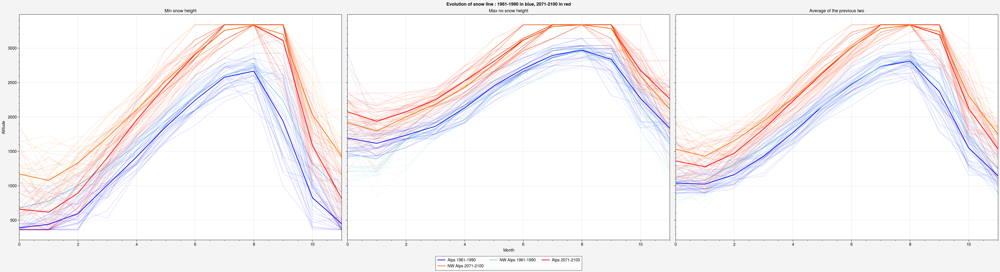

In [101]:
f,axs = pplt.subplots(axheight=7,axwidth=10, ncols=3)

for i in range(30):
    axs[0].plot(mean1_snowline_mon[0][0,i,:],alpha=0.1,c='b')
    axs[1].plot(mean1_snowline_mon[1][0,i,:],alpha=0.1,c='b')
    axs[2].plot(mean1_snowline_mon[2][0,i,:],alpha=0.1,c='b')
    
    axs[0].plot(mean1_snowline_mon[0][2,i,:],alpha=0.1,c='skyblue')
    axs[1].plot(mean1_snowline_mon[1][2,i,:],alpha=0.1,c='skyblue')
    axs[2].plot(mean1_snowline_mon[2][2,i,:],alpha=0.1,c='skyblue')
axs[0].plot(mean1_snowline_mon[0][0,:30].mean(axis=0),c='b',label='Alps 1961-1990')
axs[1].plot(mean1_snowline_mon[1][0,:30].mean(axis=0),c='b')
axs[2].plot(mean1_snowline_mon[2][0,:30].mean(axis=0),c='b')

axs[0].plot(mean1_snowline_mon[0][2,:30].mean(axis=0),c='skyblue',label='NW Alps 1961-1990')
axs[1].plot(mean1_snowline_mon[1][2,:30].mean(axis=0),c='skyblue')
axs[2].plot(mean1_snowline_mon[2][2,:30].mean(axis=0),c='skyblue')

for i in np.arange(110,140,1):
    axs[0].plot(mean1_snowline_mon[0][0,i,:],alpha=0.1,c='r')
    axs[1].plot(mean1_snowline_mon[1][0,i,:],alpha=0.1,c='r')
    axs[2].plot(mean1_snowline_mon[2][0,i,:],alpha=0.1,c='r')

    axs[0].plot(mean1_snowline_mon[0][2,i,:],alpha=0.1,c='orange')
    axs[1].plot(mean1_snowline_mon[1][2,i,:],alpha=0.1,c='orange')
    axs[2].plot(mean1_snowline_mon[2][2,i,:],alpha=0.1,c='orange')
axs[0].plot(mean1_snowline_mon[0][0,110:140].mean(axis=0),c='r',label='Alps 2071-2100')
axs[1].plot(mean1_snowline_mon[1][0,110:140].mean(axis=0),c='r')
axs[2].plot(mean1_snowline_mon[2][0,110:140].mean(axis=0),c='r')

axs[0].plot(mean1_snowline_mon[0][2,110:140].mean(axis=0),c='orange',label='NW Alps 2071-2100')
axs[1].plot(mean1_snowline_mon[1][2,110:140].mean(axis=0),c='orange')
axs[2].plot(mean1_snowline_mon[2][2,110:140].mean(axis=0),c='orange')

axs[0].format(title='Min snow height')
axs[1].format(title='Max no snow height')
axs[2].format(title='Average of the previous two')
axs.format(ylabel='Altitude',xlabel='Month',suptitle='Evolution of snow line : 1961-1990 in blue, 2071-2100 in red')
f.legend(loc='b')

In [25]:
rollmean_50yrs_mean10_minH_snow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean10_maxH_nosnow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean10_average_minmax_snow_MAM = np.full((4,90),np.nan)

rollmean_50yrs_mean1_minH_snow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean1_maxH_nosnow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean1_average_minmax_snow_MAM = np.full((4,90),np.nan)

rollmean_50yrs_mean20_minH_snow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean20_maxH_nosnow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean20_average_minmax_snow_MAM = np.full((4,90),np.nan)

rollmean_50yrs_mean30_minH_snow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean30_maxH_nosnow_MAM = np.full((4,90),np.nan)
rollmean_50yrs_mean30_average_minmax_snow_MAM = np.full((4,90),np.nan)

for j in range(4):
    for i in range(90):
        end = i+50
        rollmean_50yrs_mean10_minH_snow_MAM[j,i] = mean10_snowline_seas[0][j,i:end,1].mean()
        rollmean_50yrs_mean10_maxH_nosnow_MAM[j,i] = mean10_snowline_seas[1][j,i:end,1].mean()
        rollmean_50yrs_mean10_average_minmax_snow_MAM[j,i] = mean10_snowline_seas[2][j,i:end,1].mean()

        rollmean_50yrs_mean1_minH_snow_MAM[j,i] = mean1_snowline_seas[0][j,i:end,1].mean()
        rollmean_50yrs_mean1_maxH_nosnow_MAM[j,i] = mean1_snowline_seas[1][j,i:end,1].mean()
        rollmean_50yrs_mean1_average_minmax_snow_MAM[j,i] = mean1_snowline_seas[2][j,i:end,1].mean()

        rollmean_50yrs_mean20_minH_snow_MAM[j,i] = mean20_snowline_seas[0][j,i:end,1].mean()
        rollmean_50yrs_mean20_maxH_nosnow_MAM[j,i] = mean20_snowline_seas[1][j,i:end,1].mean()
        rollmean_50yrs_mean20_average_minmax_snow_MAM[j,i] = mean20_snowline_seas[2][j,i:end,1].mean()

        rollmean_50yrs_mean30_minH_snow_MAM[j,i] = mean30_snowline_seas[0][j,i:end,1].mean()
        rollmean_50yrs_mean30_maxH_nosnow_MAM[j,i] = mean30_snowline_seas[1][j,i:end,1].mean()
        rollmean_50yrs_mean30_average_minmax_snow_MAM[j,i] = mean30_snowline_seas[2][j,i:end,1].mean()

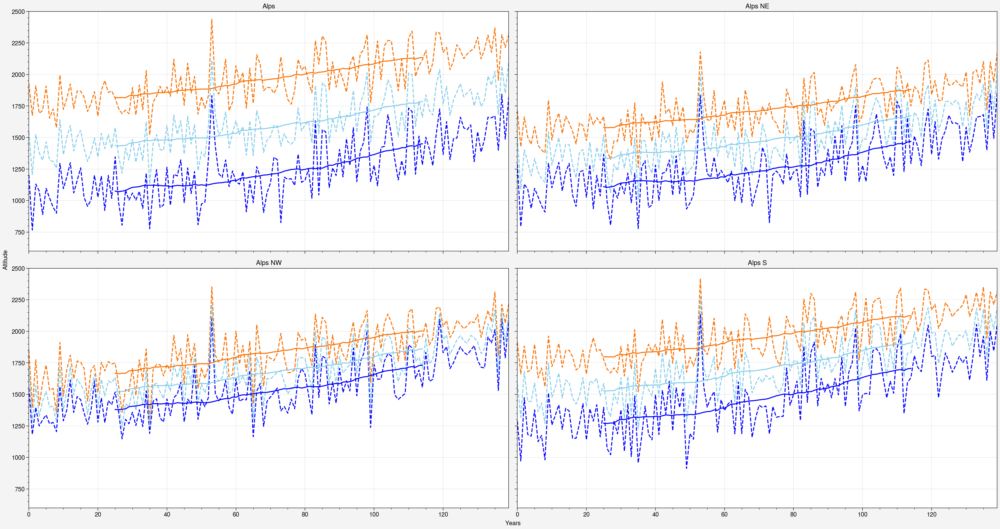

In [103]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=1

for i in range(4):
    axs[i].plot(mean10_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    axs[i].plot(mean10_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    axs[i].plot(mean10_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_minH_snow_MAM[i],c='b')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_maxH_nosnow_MAM[i],c='orange')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_average_minmax_snow_MAM[i],c='skyblue')
    axs[i].format(title=names_regions[i],ylim=[600,2500])

axs.format(xlabel='Years',ylabel='Altitude')

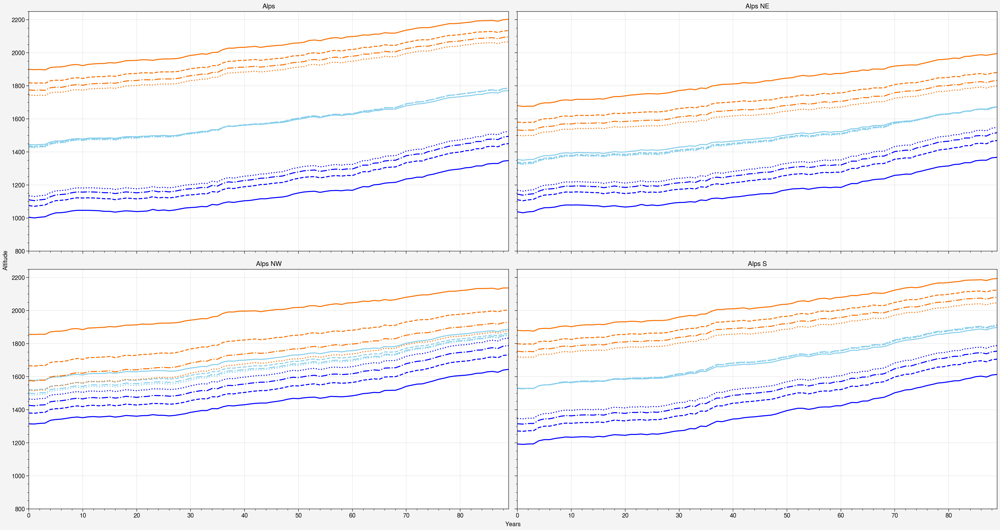

In [26]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=1

for i in range(4):
    #axs[i].plot(mean10_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    #axs[i].plot(mean10_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    #axs[i].plot(mean10_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(rollmean_50yrs_mean1_minH_snow_MAM[i],c='b')
    axs[i].plot(rollmean_50yrs_mean1_maxH_nosnow_MAM[i],c='orange')
    axs[i].plot(rollmean_50yrs_mean1_average_minmax_snow_MAM[i],c='skyblue')
    
    axs[i].plot(rollmean_50yrs_mean10_minH_snow_MAM[i],c='b',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean10_maxH_nosnow_MAM[i],c='orange',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean10_average_minmax_snow_MAM[i],c='skyblue',linestyle='--')
    
    axs[i].plot(rollmean_50yrs_mean20_minH_snow_MAM[i],c='b',linestyle='-.')
    axs[i].plot(rollmean_50yrs_mean20_maxH_nosnow_MAM[i],c='orange',linestyle='-.')
    axs[i].plot(rollmean_50yrs_mean20_average_minmax_snow_MAM[i],c='skyblue',linestyle='-.')
    
    axs[i].plot(rollmean_50yrs_mean30_minH_snow_MAM[i],c='b',linestyle=':')
    axs[i].plot(rollmean_50yrs_mean30_maxH_nosnow_MAM[i],c='orange',linestyle=':')
    axs[i].plot(rollmean_50yrs_mean30_average_minmax_snow_MAM[i],c='skyblue',linestyle=':')
    axs[i].format(title=names_regions[i],ylim=[800,2250])

axs.format(xlabel='Years',ylabel='Altitude')

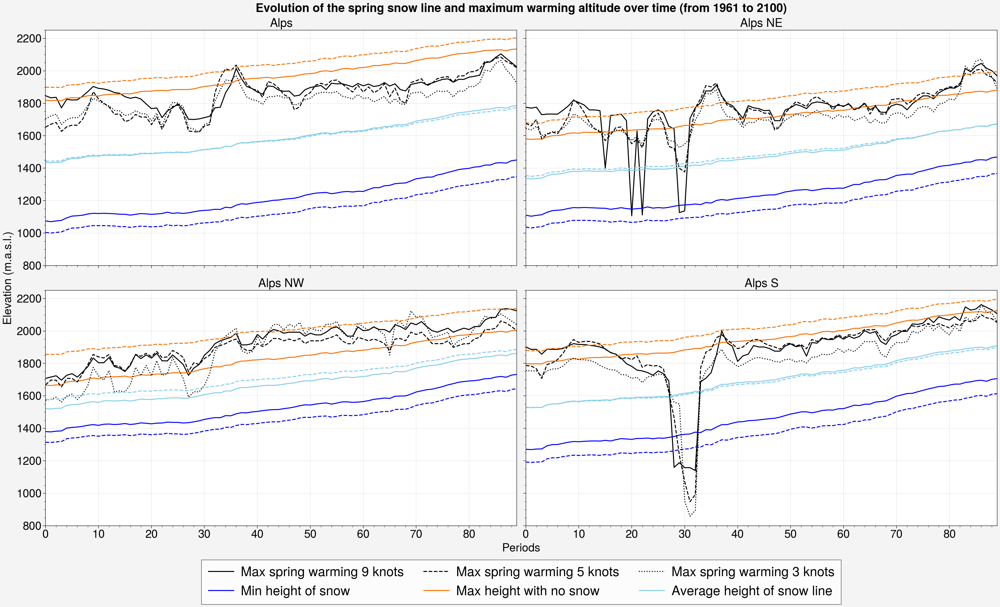

In [104]:

f,axs = pplt.subplots(nrows=2,ncols=2,axwidth=10,axheight=5)


axs[0].plot(height_max_k9_MAM[0],label='Max spring warming 9 knots',c='k')#,legend_kw={'fontsize':'30px'})
axs[0].plot(height_max_k5_MAM[0],linestyle='--',c='k',label='Max spring warming 5 knots')
axs[0].plot(height_max_k3_MAM[0],linestyle=':',c='k',label='Max spring warming 3 knots')
axs[0].plot(rollmean_50yrs_mean10_minH_snow_MAM[0],c='b',label='Min height of snow')
axs[0].plot(rollmean_50yrs_mean10_maxH_nosnow_MAM[0],c='orange',label='Max height with no snow')
axs[0].plot(rollmean_50yrs_mean10_average_minmax_snow_MAM[0],c='skyblue',label='Average height of snow line')

axs[0].plot(rollmean_50yrs_mean1_minH_snow_MAM[0],c='b',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_maxH_nosnow_MAM[0],c='orange',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_average_minmax_snow_MAM[0],c='skyblue',linestyle='--')
axs[0].format(title=names_regions[0],titlesize='25px')

for i in [1,2,3]:
    axs[i].plot(height_max_k9_MAM[i],c='k')
    axs[i].plot(rollmean_50yrs_mean10_minH_snow_MAM[i],c='b')
    axs[i].plot(rollmean_50yrs_mean10_maxH_nosnow_MAM[i],c='orange')
    axs[i].plot(rollmean_50yrs_mean10_average_minmax_snow_MAM[i],c='skyblue')

    axs[i].plot(height_max_k5_MAM[i],linestyle='--',c='k')
    axs[i].plot(height_max_k3_MAM[i],linestyle=':',c='k')
    axs[i].plot(rollmean_50yrs_mean1_minH_snow_MAM[i],c='b',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_maxH_nosnow_MAM[i],c='orange',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_average_minmax_snow_MAM[i],c='skyblue',linestyle='--')
    axs[i].format(title=names_regions[i],titlesize='25px')

#for i in range(4):
#    axs[i].legend()
f.legend(loc='b',prop = { "size": 20 })
axs.format(ylim=[800,2250],ylabel='Elevation (m.a.s.l.)',xlabel='Periods',fontsmallsize='24px',
           suptitle='Evolution of the spring snow line and maximum warming altitude over time (from 1961 to 2100)',suptitlesize='25px')

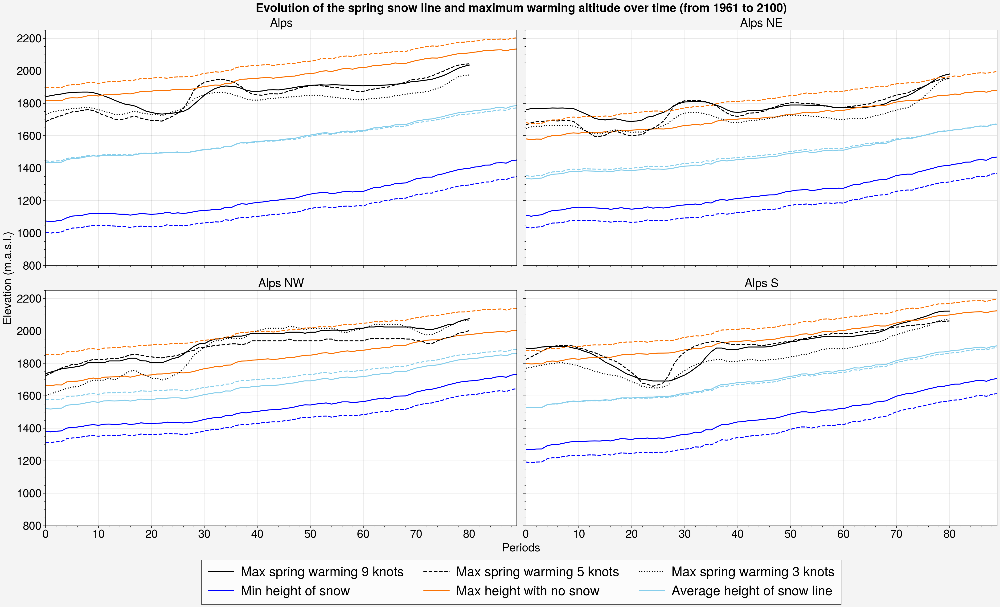

In [105]:

f,axs = pplt.subplots(nrows=2,ncols=2,axwidth=10,axheight=5)


axs[0].plot(height_max_k9_MAM_rollmean10[0],label='Max spring warming 9 knots',c='k')#,legend_kw={'fontsize':'30px'})
axs[0].plot(height_max_k5_MAM_rollmean10[0],linestyle='--',c='k',label='Max spring warming 5 knots')
axs[0].plot(height_max_k3_MAM_rollmean10[0],linestyle=':',c='k',label='Max spring warming 3 knots')
axs[0].plot(rollmean_50yrs_mean10_minH_snow_MAM[0],c='b',label='Min height of snow')
axs[0].plot(rollmean_50yrs_mean10_maxH_nosnow_MAM[0],c='orange',label='Max height with no snow')
axs[0].plot(rollmean_50yrs_mean10_average_minmax_snow_MAM[0],c='skyblue',label='Average height of snow line')

axs[0].plot(rollmean_50yrs_mean1_minH_snow_MAM[0],c='b',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_maxH_nosnow_MAM[0],c='orange',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_average_minmax_snow_MAM[0],c='skyblue',linestyle='--')
axs[0].format(title=names_regions[0],titlesize='25px')

for i in [1,2,3]:
    axs[i].plot(height_max_k9_MAM_rollmean10[i],c='k')
    axs[i].plot(rollmean_50yrs_mean10_minH_snow_MAM[i],c='b')
    axs[i].plot(rollmean_50yrs_mean10_maxH_nosnow_MAM[i],c='orange')
    axs[i].plot(rollmean_50yrs_mean10_average_minmax_snow_MAM[i],c='skyblue')

    axs[i].plot(height_max_k5_MAM_rollmean10[i],linestyle='--',c='k')
    axs[i].plot(height_max_k3_MAM_rollmean10[i],linestyle=':',c='k')
    axs[i].plot(rollmean_50yrs_mean1_minH_snow_MAM[i],c='b',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_maxH_nosnow_MAM[i],c='orange',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_average_minmax_snow_MAM[i],c='skyblue',linestyle='--')
    axs[i].format(title=names_regions[i],titlesize='25px')

#for i in range(4):
#    axs[i].legend()
f.legend(loc='b',prop = { "size": 20 })
axs.format(ylim=[800,2250],ylabel='Elevation (m.a.s.l.)',xlabel='Periods',fontsmallsize='24px',
           suptitle='Evolution of the spring snow line and maximum warming altitude over time (from 1961 to 2100)',suptitlesize='25px')

#### Summer

In [114]:
height_max_k9_JJA = spline_fit_4reg(slope_T_periods,2,9,yfitminpercent=50,yfitmaxpercent=0.2)
height_max_k5_JJA = spline_fit_4reg(slope_T_periods,2,5,yfitminpercent=50,yfitmaxpercent=0.2)
height_max_k3_JJA = spline_fit_4reg(slope_T_periods,2,3,yfitminpercent=50,yfitmaxpercent=0.2)

1778   7 (3556,)
735   2 (1471,)
273   1 (546,)
769   3 (1539,)
1778   7 (3556,)
735   2 (1471,)
273   1 (546,)
769   3 (1539,)
1778   7 (3556,)
735   2 (1471,)
273   1 (546,)
769   3 (1539,)


In [115]:
rollmean_50yrs_mean10_minH_snow_JJA = np.full((4,90),np.nan)
rollmean_50yrs_mean10_maxH_nosnow_JJA = np.full((4,90),np.nan)
rollmean_50yrs_mean10_average_minmax_snow_JJA = np.full((4,90),np.nan)

seas=2

for j in range(4):
    for i in range(90):
        end = i+50
        rollmean_50yrs_mean10_minH_snow_JJA[j,i] = mean10_snowline_seas[0][j,i:end,seas].mean()
        rollmean_50yrs_mean10_maxH_nosnow_JJA[j,i] = mean10_snowline_seas[1][j,i:end,seas].mean()
        rollmean_50yrs_mean10_average_minmax_snow_JJA[j,i] = mean10_snowline_seas[2][j,i:end,seas].mean()

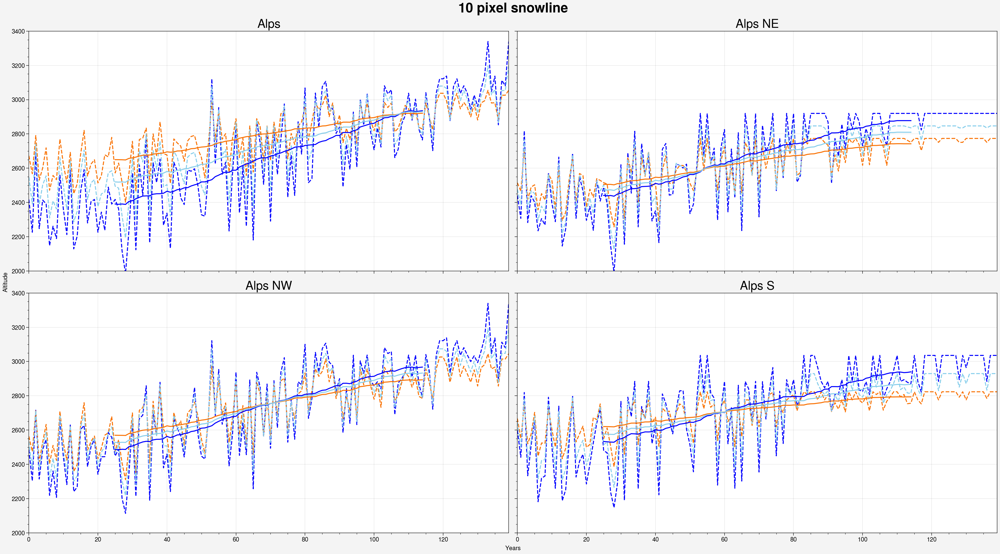

In [118]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=2

for i in range(4):
    axs[i].plot(mean10_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    axs[i].plot(mean10_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    axs[i].plot(mean10_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_minH_snow_JJA[i],c='b')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_maxH_nosnow_JJA[i],c='orange')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_average_minmax_snow_JJA[i],c='skyblue')
    axs[i].format(title=names_regions[i],ylim=[2000,3400])

axs.format(xlabel='Years',ylabel='Altitude',suptitle='10 pixel snowline',suptitlesize=20,titlesize=18)

In [119]:
mean1_minH_snow_seas = np.full((4,140,4),np.nan)
mean1_maxH_nosnow_seas = np.full((4,140,4),np.nan)
mean1_average_minmax_snow_seas = np.full((4,140,4),np.nan)

mean1_snowline_seas = [mean1_minH_snow_seas,mean1_maxH_nosnow_seas,mean1_average_minmax_snow_seas]

for reg in range(4):
    for j in range(3):
        
        mean1_snowline_seas[j][reg,:,0] = np.median(np.concatenate((mean1_snowline[j][reg,:,:59],mean1_snowline[j][reg,:,334:365]),axis=1),axis=1)
        mean1_snowline_seas[j][reg,:,1] = np.median(mean1_snowline[j][reg,:,59:151],axis=1)
        mean1_snowline_seas[j][reg,:,2] = np.median(mean1_snowline[j][reg,:,151:243],axis=1)
        mean1_snowline_seas[j][reg,:,3] = np.median(mean1_snowline[j][reg,:,243:334],axis=1)


In [120]:
rollmean_50yrs_mean1_minH_snow_JJA = np.full((4,90),np.nan)
rollmean_50yrs_mean1_maxH_nosnow_JJA = np.full((4,90),np.nan)
rollmean_50yrs_mean1_average_minmax_snow_JJA = np.full((4,90),np.nan)

seas=2

for reg in range(4):
    for i in range(90):
        end = i+50
        rollmean_50yrs_mean1_minH_snow_JJA[reg,i] = mean1_snowline_seas[0][reg,i:end,seas].mean()
        rollmean_50yrs_mean1_maxH_nosnow_JJA[reg,i] = mean1_snowline_seas[1][reg,i:end,seas].mean()
        rollmean_50yrs_mean1_average_minmax_snow_JJA[reg,i] = mean1_snowline_seas[2][reg,i:end,seas].mean()

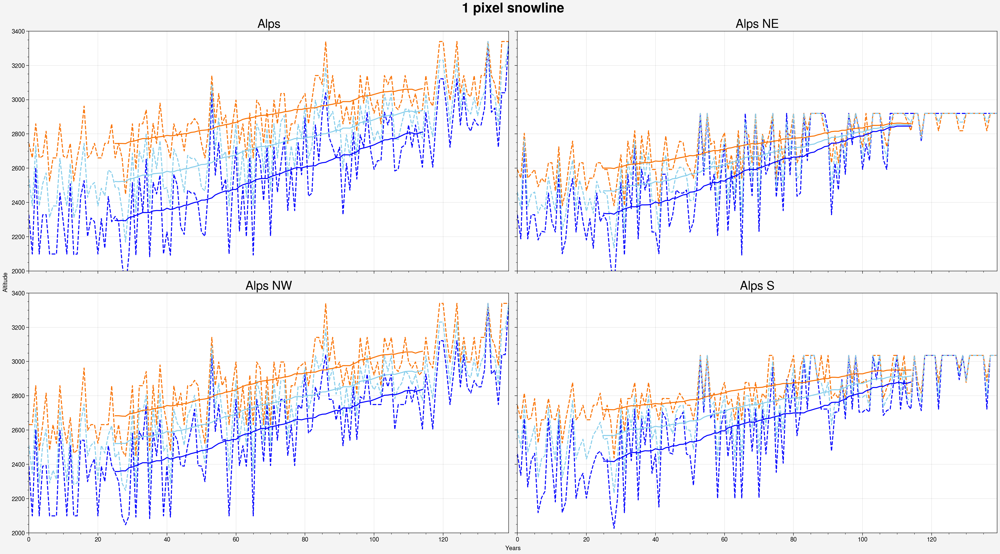

In [121]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=2

for i in range(4):
    axs[i].plot(mean1_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    axs[i].plot(mean1_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    axs[i].plot(mean1_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_minH_snow_JJA[i],c='b')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_maxH_nosnow_JJA[i],c='orange')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_average_minmax_snow_JJA[i],c='skyblue')
    axs[i].format(title=names_regions[i],ylim=[2000,3400])

axs.format(xlabel='Years',ylabel='Altitude',suptitle='1 pixel snowline',suptitlesize=20,titlesize=18)

Text(0.5, 1.0, '5 knots')

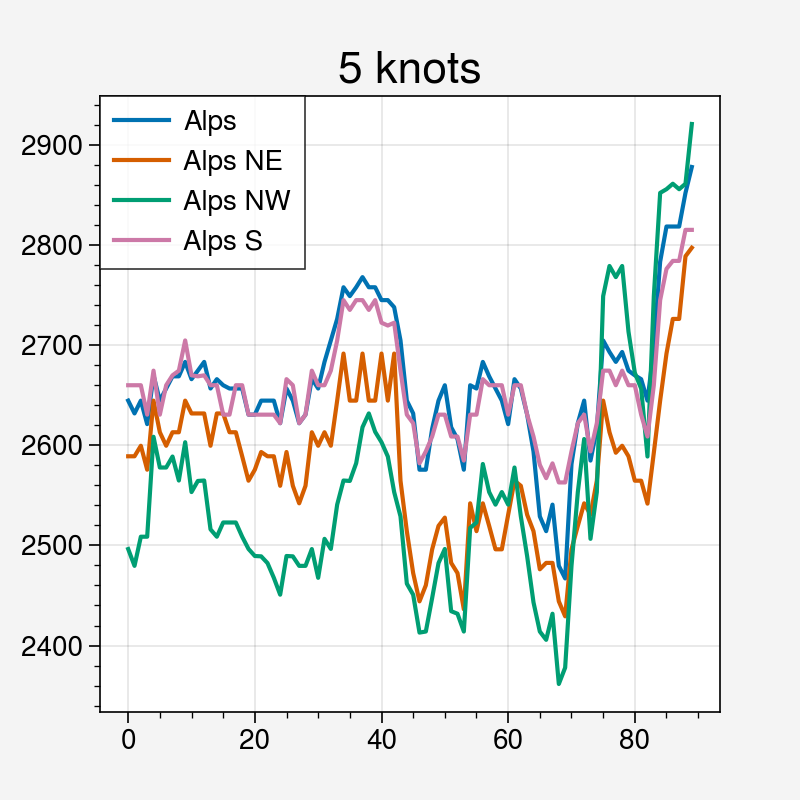

In [122]:
for i in range(4):
    plt.plot(height_max_k5_JJA[i],label=names_regions[i])

plt.legend(fontsize=10)
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
plt.title('5 knots',fontsize=16)

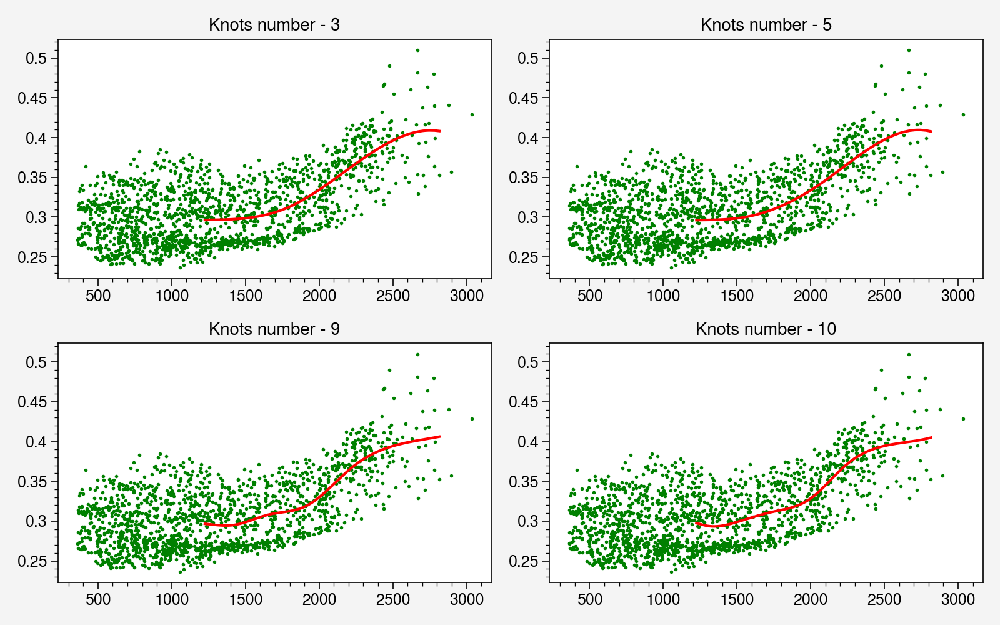

In [123]:
i=35
seas=2
yfitminpercent = 50
yfitmaxpercent = 0.2

height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[3]))
vec_height = height[height.mask == False]

slope_T_JJA = 10*np.ma.masked_array(slope_T_periods[i,seas], mask=np.invert(region_masks[3]))
vec_slope_T_JJA = slope_T_JJA[slope_T_JJA.mask == False]
        
vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_JJA), key=lambda pair: pair[0])]
vec_slope_T_JJA_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_JJA), key=lambda pair: pair[0])]


knots = [3, 5, 9, 10]
i = 0

ig, ax = plt.subplots(nrows=2, ncols=2, figsize=(8, 5))

for row in range(2):
    for col in range(2):
        ax[row][col].plot(vec_height_srt, vec_slope_T_JJA_srt, '.',c="g", markersize=2)
        yfit = spline(knots[i],vec_height_srt, vec_slope_T_JJA_srt)

        yfitmin = int(yfitminpercent/100*len(yfit))
        yfitmax = int(yfitmaxpercent/100*len(yfit))
        
        ax[row][col].plot(vec_height_srt[yfitmin:-yfitmax], yfit[yfitmin:-yfitmax], 'r')
        ax[row][col].set_title("Knots number - "+str(knots[i]))
        ax[row][col].grid()
        i=i+1
        
plt.tight_layout()        
plt.show()

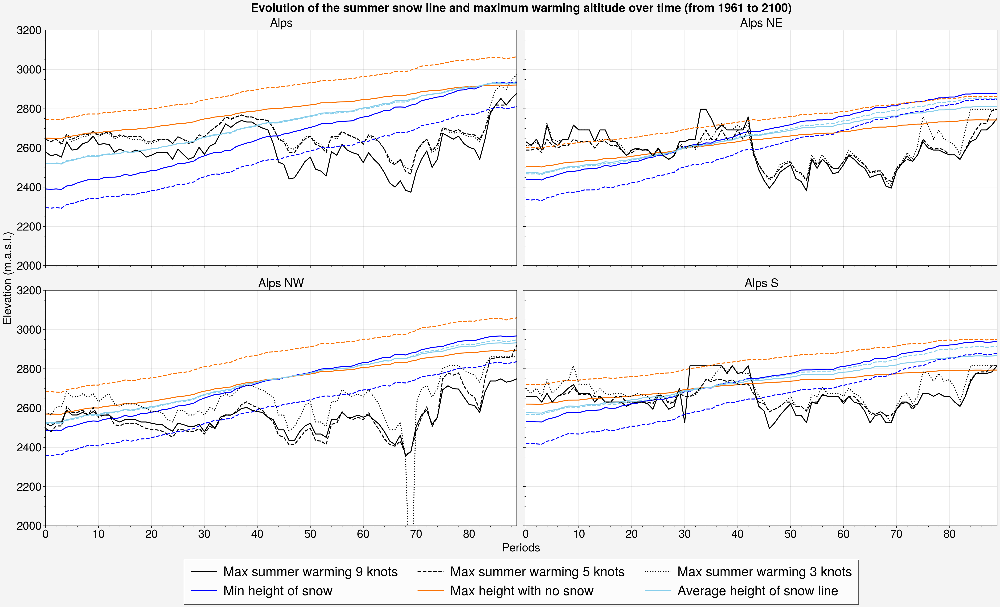

In [124]:

f,axs = pplt.subplots(nrows=2,ncols=2,axwidth=10,axheight=5)


axs[0].plot(height_max_k9_JJA[0],label='Max summer warming 9 knots',c='k')#,legend_kw={'fontsize':'30px'})
axs[0].plot(height_max_k5_JJA[0],linestyle='--',c='k',label='Max summer warming 5 knots')
axs[0].plot(height_max_k3_JJA[0],linestyle=':',c='k',label='Max summer warming 3 knots')
axs[0].plot(rollmean_50yrs_mean10_minH_snow_JJA[0],c='b',label='Min height of snow')
axs[0].plot(rollmean_50yrs_mean10_maxH_nosnow_JJA[0],c='orange',label='Max height with no snow')
axs[0].plot(rollmean_50yrs_mean10_average_minmax_snow_JJA[0],c='skyblue',label='Average height of snow line')

axs[0].plot(rollmean_50yrs_mean1_minH_snow_JJA[0],c='b',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_maxH_nosnow_JJA[0],c='orange',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_average_minmax_snow_JJA[0],c='skyblue',linestyle='--')
axs[0].format(title=names_regions[0],titlesize='25px')

for i in [1,2,3]:
    axs[i].plot(height_max_k9_JJA[i],c='k')
    axs[i].plot(rollmean_50yrs_mean10_minH_snow_JJA[i],c='b')
    axs[i].plot(rollmean_50yrs_mean10_maxH_nosnow_JJA[i],c='orange')
    axs[i].plot(rollmean_50yrs_mean10_average_minmax_snow_JJA[i],c='skyblue')

    axs[i].plot(height_max_k5_JJA[i],linestyle='--',c='k')
    axs[i].plot(height_max_k3_JJA[i],linestyle=':',c='k')
    axs[i].plot(rollmean_50yrs_mean1_minH_snow_JJA[i],c='b',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_maxH_nosnow_JJA[i],c='orange',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_average_minmax_snow_JJA[i],c='skyblue',linestyle='--')
    axs[i].format(title=names_regions[i],titlesize='25px')

#for i in range(4):
#    axs[i].legend()
f.legend(loc='b',prop = { "size": 20 })
axs.format(ylim=[2000,3200],ylabel='Elevation (m.a.s.l.)',xlabel='Periods',fontsmallsize='24px',
           suptitle='Evolution of the summer snow line and maximum warming altitude over time (from 1961 to 2100)',suptitlesize='25px')

#### Autumn

In [125]:
height_max_k9_SON = spline_fit_4reg(slope_T_periods,3,9,yfitminpercent=3,yfitmaxpercent=0.2)
height_max_k5_SON = spline_fit_4reg(slope_T_periods,3,5,yfitminpercent=3,yfitmaxpercent=0.2)
height_max_k3_SON = spline_fit_4reg(slope_T_periods,3,3,yfitminpercent=3,yfitmaxpercent=0.2)

106   7 (3556,)
44   2 (1471,)
16   1 (546,)
46   3 (1539,)
106   7 (3556,)
44   2 (1471,)
16   1 (546,)
46   3 (1539,)
106   7 (3556,)
44   2 (1471,)
16   1 (546,)
46   3 (1539,)


In [126]:
rollmean_50yrs_mean10_minH_snow_SON = np.full((4,90),np.nan)
rollmean_50yrs_mean10_maxH_nosnow_SON = np.full((4,90),np.nan)
rollmean_50yrs_mean10_average_minmax_snow_SON = np.full((4,90),np.nan)

rollmean_50yrs_mean1_minH_snow_SON = np.full((4,90),np.nan)
rollmean_50yrs_mean1_maxH_nosnow_SON = np.full((4,90),np.nan)
rollmean_50yrs_mean1_average_minmax_snow_SON = np.full((4,90),np.nan)

seas=3

for j in range(4):
    for i in range(90):
        end = i+50
        rollmean_50yrs_mean10_minH_snow_SON[j,i] = mean10_snowline_seas[0][j,i:end,seas].mean()
        rollmean_50yrs_mean10_maxH_nosnow_SON[j,i] = mean10_snowline_seas[1][j,i:end,seas].mean()
        rollmean_50yrs_mean10_average_minmax_snow_SON[j,i] = mean10_snowline_seas[2][j,i:end,seas].mean()

        rollmean_50yrs_mean1_minH_snow_SON[j,i] = mean1_snowline_seas[0][j,i:end,seas].mean()
        rollmean_50yrs_mean1_maxH_nosnow_SON[j,i] = mean1_snowline_seas[1][j,i:end,seas].mean()
        rollmean_50yrs_mean1_average_minmax_snow_SON[j,i] = mean1_snowline_seas[2][j,i:end,seas].mean()

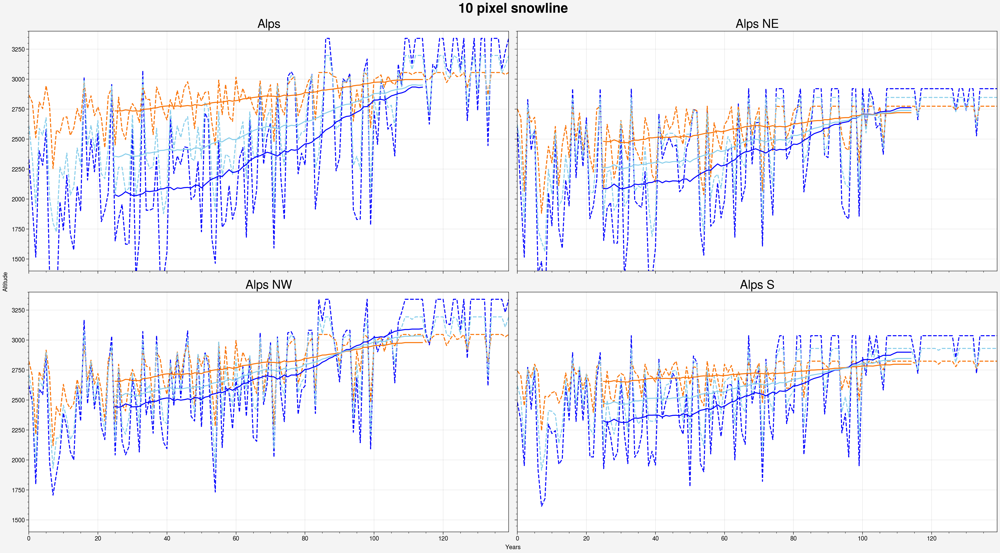

In [127]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=3

for i in range(4):
    axs[i].plot(mean10_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    axs[i].plot(mean10_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    axs[i].plot(mean10_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_minH_snow_SON[i],c='b')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_maxH_nosnow_SON[i],c='orange')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_average_minmax_snow_SON[i],c='skyblue')
    axs[i].format(title=names_regions[i],ylim=[1400,3400])

axs.format(xlabel='Years',ylabel='Altitude',suptitle='10 pixel snowline',suptitlesize=20,titlesize=18)

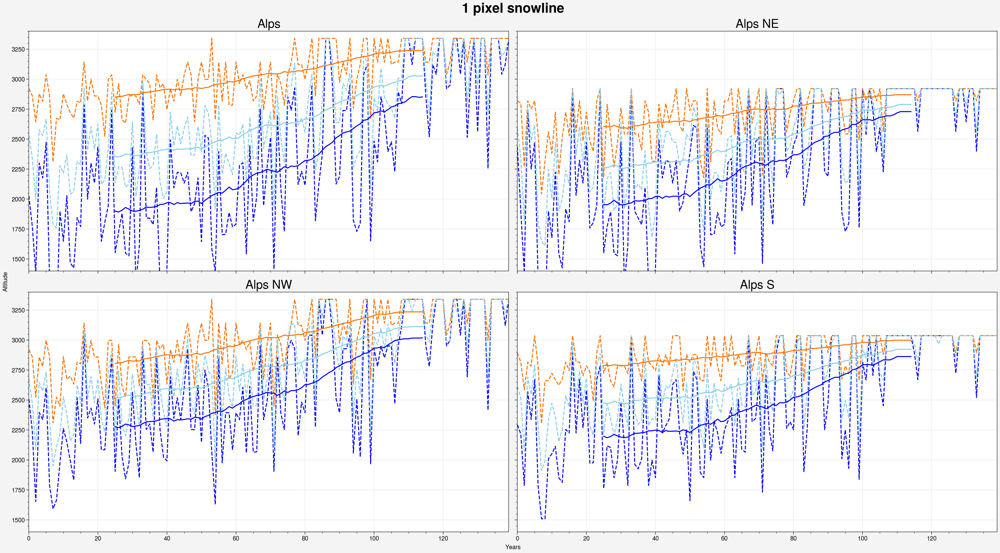

In [128]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=3

for i in range(4):
    axs[i].plot(mean1_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    axs[i].plot(mean1_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    axs[i].plot(mean1_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_minH_snow_SON[i],c='b')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_maxH_nosnow_SON[i],c='orange')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_average_minmax_snow_SON[i],c='skyblue')
    axs[i].format(title=names_regions[i],ylim=[1400,3400])

axs.format(xlabel='Years',ylabel='Altitude',suptitle='1 pixel snowline',suptitlesize=20,titlesize=18)

Text(0.5, 1.0, '5 knots')

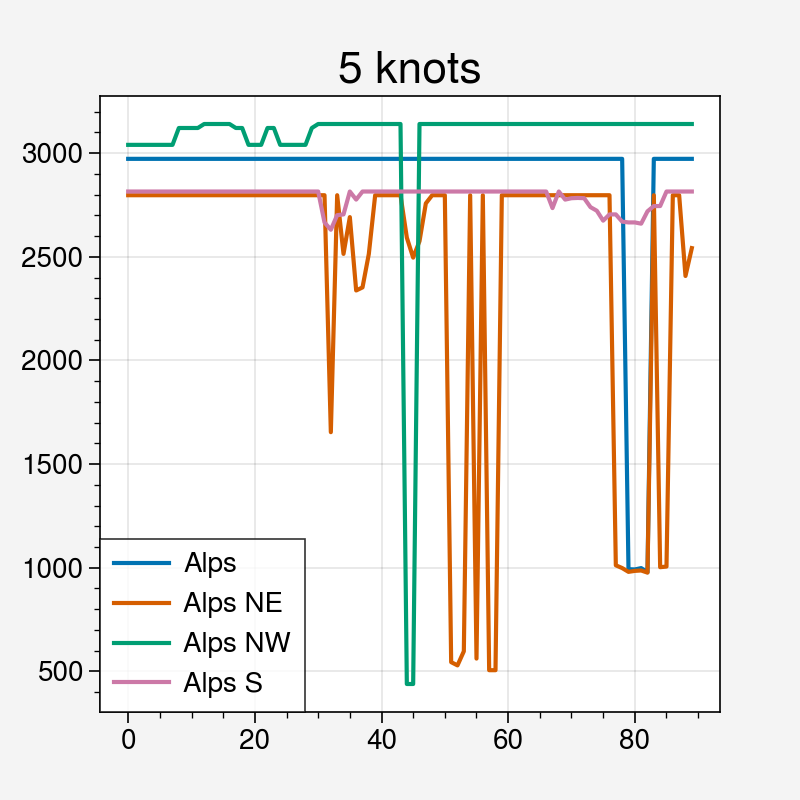

In [129]:
for i in range(4):
    plt.plot(height_max_k5_SON[i],label=names_regions[i])

plt.legend(fontsize=10)
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
plt.title('5 knots',fontsize=16)

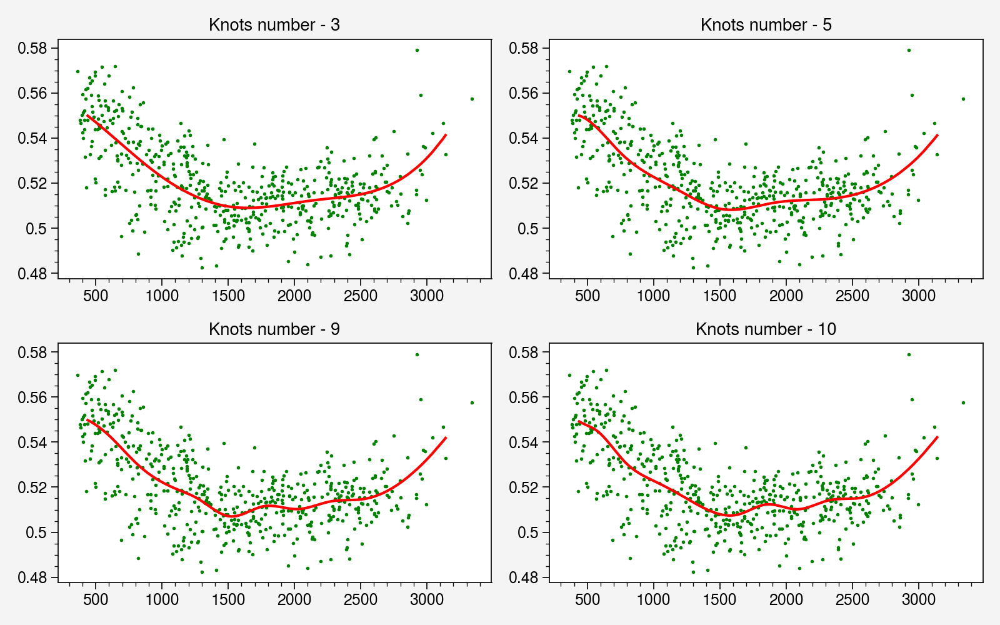

In [130]:
i=44
seas=3
yfitminpercent = 3
yfitmaxpercent = 0.2

height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[2]))
vec_height = height[height.mask == False]

slope_T_SON = 10*np.ma.masked_array(slope_T_periods[i,seas], mask=np.invert(region_masks[2]))
vec_slope_T_SON = slope_T_SON[slope_T_SON.mask == False]
        
vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_SON), key=lambda pair: pair[0])]
vec_slope_T_SON_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_SON), key=lambda pair: pair[0])]


knots = [3, 5, 9, 10]
i = 0

ig, ax = plt.subplots(nrows=2, ncols=2, figsize=(8, 5))

for row in range(2):
    for col in range(2):
        ax[row][col].plot(vec_height_srt, vec_slope_T_SON_srt, '.',c="g", markersize=2)
        yfit = spline(knots[i],vec_height_srt, vec_slope_T_SON_srt)

        yfitmin = int(yfitminpercent/100*len(yfit))
        yfitmax = int(yfitmaxpercent/100*len(yfit))
        
        ax[row][col].plot(vec_height_srt[yfitmin:-yfitmax], yfit[yfitmin:-yfitmax], 'r')
        ax[row][col].set_title("Knots number - "+str(knots[i]))
        ax[row][col].grid()
        i=i+1
        
plt.tight_layout()        
plt.show()

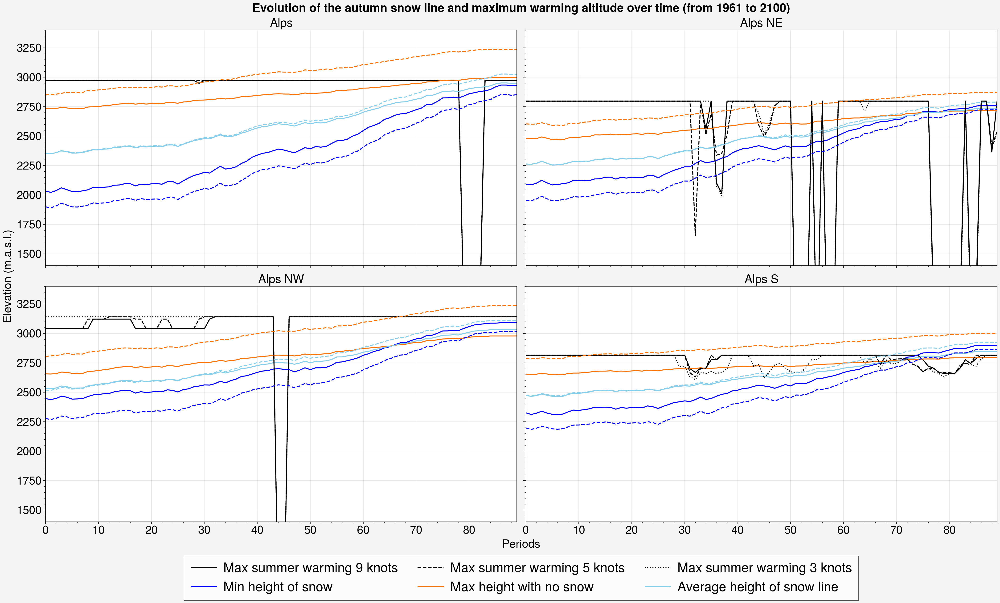

In [131]:

f,axs = pplt.subplots(nrows=2,ncols=2,axwidth=10,axheight=5)


axs[0].plot(height_max_k9_SON[0],label='Max summer warming 9 knots',c='k')#,legend_kw={'fontsize':'30px'})
axs[0].plot(height_max_k5_SON[0],linestyle='--',c='k',label='Max summer warming 5 knots')
axs[0].plot(height_max_k3_SON[0],linestyle=':',c='k',label='Max summer warming 3 knots')
axs[0].plot(rollmean_50yrs_mean10_minH_snow_SON[0],c='b',label='Min height of snow')
axs[0].plot(rollmean_50yrs_mean10_maxH_nosnow_SON[0],c='orange',label='Max height with no snow')
axs[0].plot(rollmean_50yrs_mean10_average_minmax_snow_SON[0],c='skyblue',label='Average height of snow line')

axs[0].plot(rollmean_50yrs_mean1_minH_snow_SON[0],c='b',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_maxH_nosnow_SON[0],c='orange',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_average_minmax_snow_SON[0],c='skyblue',linestyle='--')
axs[0].format(title=names_regions[0],titlesize='25px')

for i in [1,2,3]:
    axs[i].plot(height_max_k9_SON[i],c='k')
    axs[i].plot(rollmean_50yrs_mean10_minH_snow_SON[i],c='b')
    axs[i].plot(rollmean_50yrs_mean10_maxH_nosnow_SON[i],c='orange')
    axs[i].plot(rollmean_50yrs_mean10_average_minmax_snow_SON[i],c='skyblue')

    axs[i].plot(height_max_k5_SON[i],linestyle='--',c='k')
    axs[i].plot(height_max_k3_SON[i],linestyle=':',c='k')
    axs[i].plot(rollmean_50yrs_mean1_minH_snow_SON[i],c='b',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_maxH_nosnow_SON[i],c='orange',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_average_minmax_snow_SON[i],c='skyblue',linestyle='--')
    axs[i].format(title=names_regions[i],titlesize='25px')

#for i in range(4):
#    axs[i].legend()
f.legend(loc='b',prop = { "size": 20 })
axs.format(ylim=[1400,3400],ylabel='Elevation (m.a.s.l.)',xlabel='Periods',fontsmallsize='24px',
           suptitle='Evolution of the autumn snow line and maximum warming altitude over time (from 1961 to 2100)',suptitlesize='25px')

#### Winter

In [132]:
height_max_k9_DJF = spline_fit_4reg(slope_T_periods,0,9,yfitminpercent=3,yfitmaxpercent=0.2)
height_max_k5_DJF = spline_fit_4reg(slope_T_periods,0,5,yfitminpercent=3,yfitmaxpercent=0.2)
height_max_k3_DJF = spline_fit_4reg(slope_T_periods,0,3,yfitminpercent=3,yfitmaxpercent=0.2)

106   7 (3556,)
44   2 (1471,)
16   1 (546,)
46   3 (1539,)
106   7 (3556,)
44   2 (1471,)
16   1 (546,)
46   3 (1539,)
106   7 (3556,)
44   2 (1471,)
16   1 (546,)
46   3 (1539,)


In [133]:
rollmean_50yrs_mean10_minH_snow_DJF = np.full((4,90),np.nan)
rollmean_50yrs_mean10_maxH_nosnow_DJF = np.full((4,90),np.nan)
rollmean_50yrs_mean10_average_minmax_snow_DJF = np.full((4,90),np.nan)

rollmean_50yrs_mean1_minH_snow_DJF = np.full((4,90),np.nan)
rollmean_50yrs_mean1_maxH_nosnow_DJF = np.full((4,90),np.nan)
rollmean_50yrs_mean1_average_minmax_snow_DJF = np.full((4,90),np.nan)

seas=0

for j in range(4):
    for i in range(90):
        end = i+50
        rollmean_50yrs_mean10_minH_snow_DJF[j,i] = mean10_snowline_seas[0][j,i:end,seas].mean()
        rollmean_50yrs_mean10_maxH_nosnow_DJF[j,i] = mean10_snowline_seas[1][j,i:end,seas].mean()
        rollmean_50yrs_mean10_average_minmax_snow_DJF[j,i] = mean10_snowline_seas[2][j,i:end,seas].mean()

        rollmean_50yrs_mean1_minH_snow_DJF[j,i] = mean1_snowline_seas[0][j,i:end,seas].mean()
        rollmean_50yrs_mean1_maxH_nosnow_DJF[j,i] = mean1_snowline_seas[1][j,i:end,seas].mean()
        rollmean_50yrs_mean1_average_minmax_snow_DJF[j,i] = mean1_snowline_seas[2][j,i:end,seas].mean()

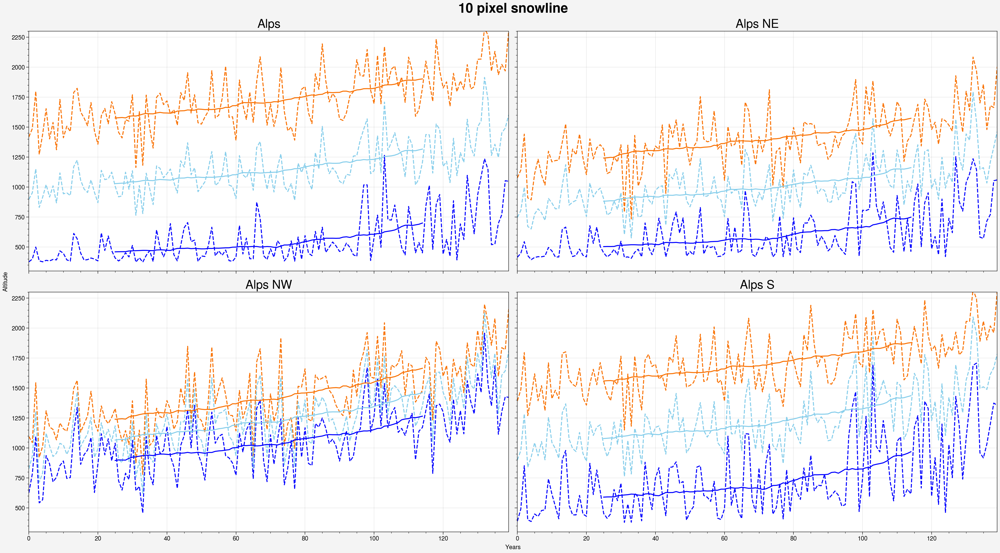

In [136]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=0

for i in range(4):
    axs[i].plot(mean10_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    axs[i].plot(mean10_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    axs[i].plot(mean10_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_minH_snow_DJF[i],c='b')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_maxH_nosnow_DJF[i],c='orange')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean10_average_minmax_snow_DJF[i],c='skyblue')
    axs[i].format(title=names_regions[i],ylim=[300,2300])

axs.format(xlabel='Years',ylabel='Altitude',suptitle='10 pixel snowline',suptitlesize=20,titlesize=18)

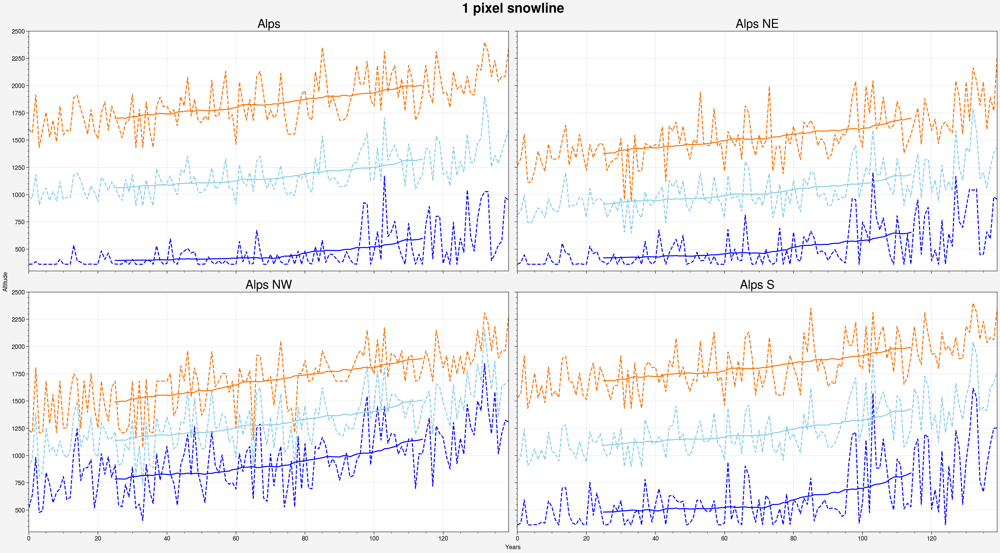

In [138]:
f,axs = pplt.subplots(axheight=5,axwidth=10,ncols=2,nrows=2)

seas=0

for i in range(4):
    axs[i].plot(mean1_snowline_seas[0][i,:,seas],linestyle='--',c='b')
    axs[i].plot(mean1_snowline_seas[1][i,:,seas],linestyle='--',c='orange')
    axs[i].plot(mean1_snowline_seas[2][i,:,seas],linestyle='--',c='skyblue')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_minH_snow_DJF[i],c='b')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_maxH_nosnow_DJF[i],c='orange')
    axs[i].plot(np.arange(25,115,1),rollmean_50yrs_mean1_average_minmax_snow_DJF[i],c='skyblue')
    axs[i].format(title=names_regions[i],ylim=[300,2500])

axs.format(xlabel='Years',ylabel='Altitude',suptitle='1 pixel snowline',suptitlesize=20,titlesize=18)

Text(0.5, 1.0, '5 knots')

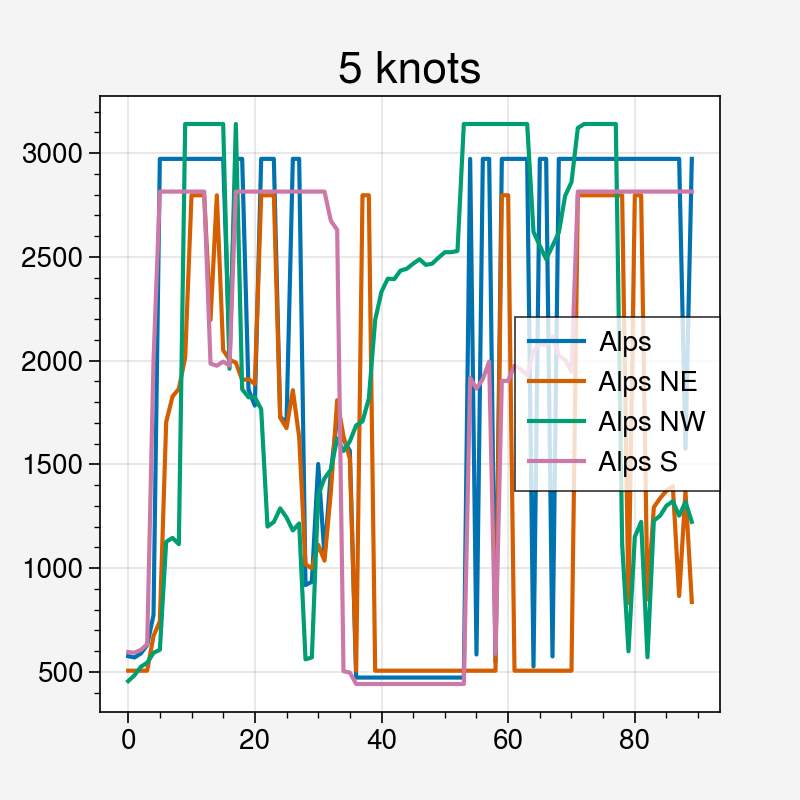

In [139]:
for i in range(4):
    plt.plot(height_max_k5_DJF[i],label=names_regions[i])

plt.legend(fontsize=10)
plt.yticks(fontsize=10)
plt.xticks(fontsize=10)
plt.title('5 knots',fontsize=16)

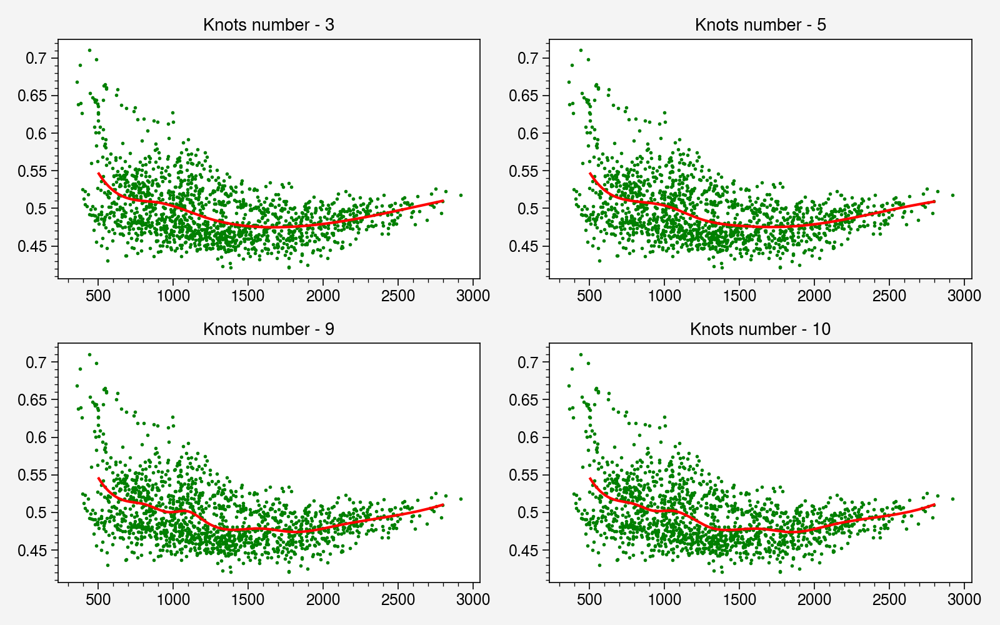

In [147]:
i=61
seas=0
yfitminpercent = 3
yfitmaxpercent = 0.2

height = np.ma.masked_array(ds.SH[jmin:jmax,imin:imax], mask=np.invert(region_masks[1]))
vec_height = height[height.mask == False]

slope_T_DJF = 10*np.ma.masked_array(slope_T_periods[i,seas], mask=np.invert(region_masks[1]))
vec_slope_T_DJF = slope_T_DJF[slope_T_DJF.mask == False]
        
vec_height_srt = [y for (y,x) in sorted(zip(vec_height,vec_slope_T_DJF), key=lambda pair: pair[0])]
vec_slope_T_DJF_srt = [x for (y,x) in sorted(zip(vec_height,vec_slope_T_DJF), key=lambda pair: pair[0])]


knots = [3, 5, 9, 10]
i = 0

ig, ax = plt.subplots(nrows=2, ncols=2, figsize=(8, 5))

for row in range(2):
    for col in range(2):
        ax[row][col].plot(vec_height_srt, vec_slope_T_DJF_srt, '.',c="g", markersize=2)
        yfit = spline(knots[i],vec_height_srt, vec_slope_T_DJF_srt)

        yfitmin = int(yfitminpercent/100*len(yfit))
        yfitmax = int(yfitmaxpercent/100*len(yfit))
        
        ax[row][col].plot(vec_height_srt[yfitmin:-yfitmax], yfit[yfitmin:-yfitmax], 'r')
        ax[row][col].set_title("Knots number - "+str(knots[i]))
        ax[row][col].grid()
        i=i+1
        
plt.tight_layout()        
plt.show()

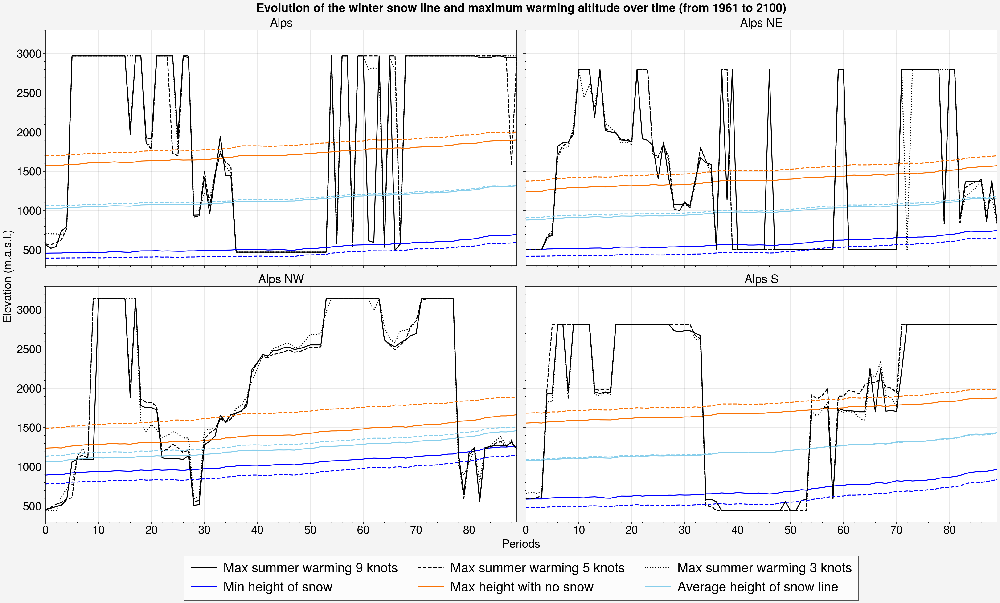

In [149]:

f,axs = pplt.subplots(nrows=2,ncols=2,axwidth=10,axheight=5)


axs[0].plot(height_max_k9_DJF[0],label='Max summer warming 9 knots',c='k')#,legend_kw={'fontsize':'30px'})
axs[0].plot(height_max_k5_DJF[0],linestyle='--',c='k',label='Max summer warming 5 knots')
axs[0].plot(height_max_k3_DJF[0],linestyle=':',c='k',label='Max summer warming 3 knots')
axs[0].plot(rollmean_50yrs_mean10_minH_snow_DJF[0],c='b',label='Min height of snow')
axs[0].plot(rollmean_50yrs_mean10_maxH_nosnow_DJF[0],c='orange',label='Max height with no snow')
axs[0].plot(rollmean_50yrs_mean10_average_minmax_snow_DJF[0],c='skyblue',label='Average height of snow line')

axs[0].plot(rollmean_50yrs_mean1_minH_snow_DJF[0],c='b',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_maxH_nosnow_DJF[0],c='orange',linestyle='--')
axs[0].plot(rollmean_50yrs_mean1_average_minmax_snow_DJF[0],c='skyblue',linestyle='--')
axs[0].format(title=names_regions[0],titlesize='25px')

for i in [1,2,3]:
    axs[i].plot(height_max_k9_DJF[i],c='k')
    axs[i].plot(rollmean_50yrs_mean10_minH_snow_DJF[i],c='b')
    axs[i].plot(rollmean_50yrs_mean10_maxH_nosnow_DJF[i],c='orange')
    axs[i].plot(rollmean_50yrs_mean10_average_minmax_snow_DJF[i],c='skyblue')

    axs[i].plot(height_max_k5_DJF[i],linestyle='--',c='k')
    axs[i].plot(height_max_k3_DJF[i],linestyle=':',c='k')
    axs[i].plot(rollmean_50yrs_mean1_minH_snow_DJF[i],c='b',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_maxH_nosnow_DJF[i],c='orange',linestyle='--')
    axs[i].plot(rollmean_50yrs_mean1_average_minmax_snow_DJF[i],c='skyblue',linestyle='--')
    axs[i].format(title=names_regions[i],titlesize='25px')

#for i in range(4):
#    axs[i].legend()
f.legend(loc='b',prop = { "size": 20 })
axs.format(ylim=[300,3300],ylabel='Elevation (m.a.s.l.)',xlabel='Periods',fontsmallsize='24px',
           suptitle='Evolution of the winter snow line and maximum warming altitude over time (from 1961 to 2100)',suptitlesize='25px')